# Analise Exploratoria dos Microdados do ENEM

## Importando bibliotecas

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, FFMpegWriter
import numpy as np
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.colors as pc
from IPython.display import HTML
import webbrowser
import os
from pathlib import Path
import re
import ipynbname

In [2]:
# Tirando os warnigs
import warnings
warnings.filterwarnings("ignore")

## Importando dados

In [3]:
# Diretorio do notebook
notebook_path = Path(ipynbname.path())
notebook_dir = notebook_path.parent

# Diretorio pai do notebook
notebook_dir_parent = notebook_dir.parent

# Trocar o diretorio 
%cd {notebook_dir_parent}

C:\Users\mht-1\OneDrive\Documentos\Projetos\Dados\analises_enem


In [4]:
# Dados Enem
dados_enem = pd.read_csv("dados/microdados_enem_2018/DADOS/MICRODADOS_ENEM_2018.csv", sep=";", encoding="ISO-8859-1")

# Dados IDHM
dados_idhm = pd.read_csv("dados/atlas2013_dadosbrutos_idhm_pt.csv", sep=";")

# Dados Municipios
dados_municipio = pd.read_csv("dados/brasil-municipios.csv", sep=",")


In [5]:
# Dicionario dos dados do Enem

# Faixa etaria
dicionario_dados_enem_idade = pd.read_excel("dados/microdados_enem_2018/DICIONARIO/Dicionario_Microdados_Enem_2018.xlsx",
                                             usecols="C:D",
                                             skiprows = 7,
                                             nrows = 20,
                                             header = None,
                                             names = ["categoria_idade", "descricao_idade"]
                                           )
                                            

# Tipo de Escola do Ensino Medio
dicionario_dados_enem_escola = pd.read_excel("dados/microdados_enem_2018/DICIONARIO/Dicionario_Microdados_Enem_2018.xlsx",
                                             usecols="C:D",
                                             skiprows = 61,
                                             nrows = 4,
                                             header = None,
                                             names = ["categoria_escola", "descricao_escola"]
                                            )

# Resposta questionario 1 e 2
dicionario_dados_enem_q001_q002 = pd.read_excel("dados/microdados_enem_2018/DICIONARIO/Dicionario_Microdados_Enem_2018.xlsx",
                                                 usecols="C:D",
                                                 skiprows = 181,
                                                 nrows = 8,
                                                 header = None,
                                                 names = ["categoria_q001_q002", "descricao_q001_q002"]
                                               )

# Resposta questionario 6
dicionario_dados_enem_q006 = pd.read_excel("dados/microdados_enem_2018/DICIONARIO/Dicionario_Microdados_Enem_2018.xlsx",
                                             usecols="C:D",
                                             skiprows = 229,
                                             nrows = 17,
                                             header = None,
                                             names = ["categoria_q006", "descricao_q006"]
                                          )

# Resposta questionario 27
dicionario_dados_enem_q027 = pd.read_excel("dados/microdados_enem_2018/DICIONARIO/Dicionario_Microdados_Enem_2018.xlsx",
                                             usecols="C:D",
                                             skiprows = 329,
                                             nrows = 6,
                                             header = None,
                                             names = ["categoria_q027", "descricao_q027"]
                                          )

In [6]:
# Visualizando dados do dicionario do enem
dicionario_dados_enem_idade

,categoria_idade,descricao_idade
0,1,Menor de 17 anos
1,2,17 anos
2,3,18 anos
3,4,19 anos
4,5,20 anos
5,6,21 anos
6,7,22 anos
7,8,23 anos
8,9,24 anos
9,10,25 anos


In [7]:
dicionario_dados_enem_escola

,categoria_escola,descricao_escola
0,1,Não Respondeu
1,2,Pública
2,3,Exterior
3,4,Privada


In [8]:
dicionario_dados_enem_q001_q002

,categoria_q001_q002,descricao_q001_q002
0,A,Nunca estudou.
1,B,Não completou a 4ª série/5º ano do Ensino Fund...
2,C,"Completou a 4ª série/5º ano, mas não completou..."
3,D,Completou a 8ª série/9º ano do Ensino Fundamen...
4,E,"Completou o Ensino Médio, mas não completou a ..."
5,F,"Completou a Faculdade, mas não completou a Pós..."
6,G,Completou a Pós-graduação.
7,H,Não sei.


In [9]:
dicionario_dados_enem_q006

,categoria_q006,descricao_q006
0,A,Nenhuma renda.
1,B,"Até R$ 954,00."
2,C,"De R$ 954,01 até R$ 1.431,00."
3,D,"De R$ 1.431,01 até R$ 1.908,00."
4,E,"De R$ 1.908,01 até R$ 2.385,00."
5,F,"De R$ 2.385,01 até R$ 2.862,00."
6,G,"De R$ 2.862,01 até R$ 3.816,00."
7,H,"De R$ 3.816,01 até R$ 4.770,00."
8,I,"De R$ 4.770,01 até R$ 5.724,00."
9,J,"De R$ 5.724,01 até R$ 6.678,00."


In [10]:
dicionario_dados_enem_q027

,categoria_q027,descricao_q027
0,A,Somente em escola pública.
1,B,Parte em escola pública e parte em escola priv...
2,C,Parte em escola pública e parte em escola priv...
3,D,Somente em escola privada SEM bolsa de estudo ...
4,E,Somente em escola privada COM bolsa de estudo ...
5,F,Não frequentei a escola


## Tratando Dados

### Enem

In [11]:
# Visualizando head do enem
dados_enem.head()

,NU_INSCRICAO,NU_ANO,TP_FAIXA_ETARIA,TP_SEXO,TP_ESTADO_CIVIL,TP_COR_RACA,TP_NACIONALIDADE,TP_ST_CONCLUSAO,TP_ANO_CONCLUIU,TP_ESCOLA,...,Q018,Q019,Q020,Q021,Q022,Q023,Q024,Q025,Q026,Q027
0,180007186625,2018,2,F,0.0,4,1,2,0,4,...,B,C,B,B,D,B,C,B,B,D
1,180007186627,2018,3,F,0.0,4,1,1,1,1,...,A,B,A,A,B,A,A,A,A,A
2,180007186628,2018,3,M,0.0,0,1,2,0,2,...,A,B,B,A,D,A,A,A,B,A
3,180007186629,2018,2,F,0.0,3,1,2,0,4,...,A,C,A,B,D,B,A,B,B,B
4,180007186631,2018,11,F,0.0,5,1,1,6,1,...,A,B,B,A,C,A,B,A,A,A


In [12]:
# Visualizando os nomes das colunas
dados_enem.columns.values

array(['NU_INSCRICAO', 'NU_ANO', 'TP_FAIXA_ETARIA', 'TP_SEXO',
       'TP_ESTADO_CIVIL', 'TP_COR_RACA', 'TP_NACIONALIDADE',
       'TP_ST_CONCLUSAO', 'TP_ANO_CONCLUIU', 'TP_ESCOLA', 'TP_ENSINO',
       'IN_TREINEIRO', 'CO_MUNICIPIO_ESC', 'NO_MUNICIPIO_ESC',
       'CO_UF_ESC', 'SG_UF_ESC', 'TP_DEPENDENCIA_ADM_ESC',
       'TP_LOCALIZACAO_ESC', 'TP_SIT_FUNC_ESC', 'CO_MUNICIPIO_PROVA',
       'NO_MUNICIPIO_PROVA', 'CO_UF_PROVA', 'SG_UF_PROVA',
       'TP_PRESENCA_CN', 'TP_PRESENCA_CH', 'TP_PRESENCA_LC',
       'TP_PRESENCA_MT', 'CO_PROVA_CN', 'CO_PROVA_CH', 'CO_PROVA_LC',
       'CO_PROVA_MT', 'NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC',
       'NU_NOTA_MT', 'TX_RESPOSTAS_CN', 'TX_RESPOSTAS_CH',
       'TX_RESPOSTAS_LC', 'TX_RESPOSTAS_MT', 'TP_LINGUA',
       'TX_GABARITO_CN', 'TX_GABARITO_CH', 'TX_GABARITO_LC',
       'TX_GABARITO_MT', 'TP_STATUS_REDACAO', 'NU_NOTA_COMP1',
       'NU_NOTA_COMP2', 'NU_NOTA_COMP3', 'NU_NOTA_COMP4', 'NU_NOTA_COMP5',
       'NU_NOTA_REDACAO', 'Q001', 'Q002', '

In [13]:
# Colunas selecionadas
colunas_sel_enem = ['NU_INSCRICAO',
                   'TP_FAIXA_ETARIA', 'TP_SEXO', 'TP_ESCOLA',
                   'CO_MUNICIPIO_ESC', 'SG_UF_ESC', 
                   'NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT','NU_NOTA_REDACAO', 
                   'Q001', 'Q002', 'Q006', 'Q027' ]

# Filtrando colunas selecionadas
dados_enem_sel = dados_enem.filter(items=colunas_sel_enem)

In [14]:
# Visualizando dados
dados_enem_sel.head()

,NU_INSCRICAO,TP_FAIXA_ETARIA,TP_SEXO,TP_ESCOLA,CO_MUNICIPIO_ESC,SG_UF_ESC,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,NU_NOTA_REDACAO,Q001,Q002,Q006,Q027
0,180007186625,2,F,4,1500800.0,PA,534.2,611.4,517.9,496.3,360.0,E,E,F,D
1,180007186627,3,F,1,NaN,NaN,506.9,477.8,495.3,440.6,420.0,D,E,B,A
2,180007186628,3,M,2,3155603.0,MG,470.6,473.8,534.4,410.4,600.0,B,B,B,A
3,180007186629,2,F,4,1500800.0,PA,588.9,663.3,614.5,711.5,800.0,F,F,I,B
4,180007186631,11,F,1,NaN,NaN,477.8,621.5,519.4,543.1,500.0,A,E,C,A


In [15]:
# Removendo dados que possuem algum dado em branco
dados_enem_sel = dados_enem_sel.dropna()

In [16]:
# Convertendo o codigo do municipio de float para int
dados_enem_sel['CO_MUNICIPIO_ESC'] = dados_enem_sel['CO_MUNICIPIO_ESC'].apply(lambda x: int(x))

In [17]:
# Visualizando head do enem
dados_enem_sel.head()

,NU_INSCRICAO,TP_FAIXA_ETARIA,TP_SEXO,TP_ESCOLA,CO_MUNICIPIO_ESC,SG_UF_ESC,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,NU_NOTA_REDACAO,Q001,Q002,Q006,Q027
0,180007186625,2,F,4,1500800,PA,534.2,611.4,517.9,496.3,360.0,E,E,F,D
2,180007186628,3,M,2,3155603,MG,470.6,473.8,534.4,410.4,600.0,B,B,B,A
3,180007186629,2,F,4,1500800,PA,588.9,663.3,614.5,711.5,800.0,F,F,I,B
5,180007186632,2,F,2,3161106,MG,415.9,485.6,512.5,534.9,540.0,E,E,D,B
11,180007186638,2,F,2,2927408,BA,531.8,613.7,575.0,481.6,680.0,E,D,C,A


### IDHM

In [18]:
# Visualizando head do IDHM
dados_idhm.head()

,ANO,UF,Codmun6,Codmun7,Município,IDHM,IDHM_E,IDHM_L,IDHM_R
0,2010,11,110001,1100015,ALTA FLORESTA D'OESTE,"0,641","0,526","0,763","0,657"
1,2010,11,110002,1100023,ARIQUEMES,"0,702","0,600","0,806","0,716"
2,2010,11,110003,1100031,CABIXI,"0,650","0,559","0,757","0,650"
3,2010,11,110004,1100049,CACOAL,"0,718","0,620","0,821","0,727"
4,2010,11,110005,1100056,CEREJEIRAS,"0,692","0,602","0,799","0,688"


In [19]:
# Visualizando os nomes das colunas
dados_idhm.columns.values

array(['ANO', 'UF', 'Codmun6', 'Codmun7', 'Município', 'IDHM', 'IDHM_E',
       'IDHM_L', 'IDHM_R'], dtype=object)

In [20]:
# Colunas selecionadas
colunas_sel_idhm = ['Codmun7', 'Município', 
                    'IDHM', 'IDHM_E','IDHM_L', 'IDHM_R']

# Filtrando colunas selecionadas
dados_idhm_sel = dados_idhm.filter(items=colunas_sel_idhm)

In [21]:
# Visualizando dados
dados_idhm_sel.head()

,Codmun7,Município,IDHM,IDHM_E,IDHM_L,IDHM_R
0,1100015,ALTA FLORESTA D'OESTE,"0,641","0,526","0,763","0,657"
1,1100023,ARIQUEMES,"0,702","0,600","0,806","0,716"
2,1100031,CABIXI,"0,650","0,559","0,757","0,650"
3,1100049,CACOAL,"0,718","0,620","0,821","0,727"
4,1100056,CEREJEIRAS,"0,692","0,602","0,799","0,688"


### Municipios com Latitude e longitude

In [22]:
# Visualizando head do municipios
dados_municipio.head()

,codigo_ibge,nome,latitude,longitude,capital,codigo_uf
0,5200050,Abadia de Goiás,-16.75730,-49.4412,0,52
1,3100104,Abadia dos Dourados,-18.48310,-47.3916,0,31
2,5200100,Abadiânia,-16.19700,-48.7057,0,52
3,3100203,Abaeté,-19.15510,-45.4444,0,31
4,1500107,Abaetetuba,-1.72183,-48.8788,0,15


In [23]:
# Visualizando os nomes das colunas
dados_municipio.head().columns.values

array(['codigo_ibge', 'nome', 'latitude', 'longitude', 'capital',
       'codigo_uf'], dtype=object)

In [24]:
# Colunas selecionadas
colunas_sel_municipio = ['codigo_ibge', 
                         'latitude', 'longitude']

# Filtrando colunas selecionadas
dados_municipio_sel = dados_municipio.filter(items=colunas_sel_municipio)

In [25]:
# Visualizando dados
dados_municipio_sel.head()

,codigo_ibge,latitude,longitude
0,5200050,-16.75730,-49.4412
1,3100104,-18.48310,-47.3916
2,5200100,-16.19700,-48.7057
3,3100203,-19.15510,-45.4444
4,1500107,-1.72183,-48.8788


### Juntando tabelas

In [26]:
# Juntando dados dos dicionarios do enem

# Faixa etaria
dados_consolidados = pd.merge(dados_enem_sel, dicionario_dados_enem_idade, how = 'left', left_on = ['TP_FAIXA_ETARIA'], right_on = ['categoria_idade'])

# Tipo escola ensino medio
dados_consolidados = pd.merge(dados_consolidados, dicionario_dados_enem_escola, how = 'left', left_on = ['TP_ESCOLA'], right_on = ['categoria_escola'])

# Resposta questionario q006
dados_consolidados = pd.merge(dados_consolidados, dicionario_dados_enem_q006, how = 'left', left_on = ['Q006'], right_on = ['categoria_q006'])

# Resposta questionario q001 e q002
dados_consolidados = pd.merge(dados_consolidados, dicionario_dados_enem_q027, how = 'left', left_on = ['Q027'], right_on = ['categoria_q027'])

# Resposta questionario q001 e q002 (como ambos possuem a mesma descricao, fazer de outra forma)
dict_q001_q002 = pd.Series(dicionario_dados_enem_q001_q002.descricao_q001_q002.values,index=dicionario_dados_enem_q001_q002.categoria_q001_q002).to_dict()
dados_consolidados['descricao_q001'] = [dict_q001_q002[resp] for resp in dados_consolidados.Q001]
dados_consolidados['descricao_q002'] = [dict_q001_q002[resp] for resp in dados_consolidados.Q002]

In [27]:
dados_consolidados.head()

,NU_INSCRICAO,TP_FAIXA_ETARIA,TP_SEXO,TP_ESCOLA,CO_MUNICIPIO_ESC,SG_UF_ESC,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,...,categoria_idade,descricao_idade,categoria_escola,descricao_escola,categoria_q006,descricao_q006,categoria_q027,descricao_q027,descricao_q001,descricao_q002
0,180007186625,2,F,4,1500800,PA,534.2,611.4,517.9,496.3,...,2,17 anos,4,Privada,F,"De R$ 2.385,01 até R$ 2.862,00.",D,Somente em escola privada SEM bolsa de estudo ...,"Completou o Ensino Médio, mas não completou a ...","Completou o Ensino Médio, mas não completou a ..."
1,180007186628,3,M,2,3155603,MG,470.6,473.8,534.4,410.4,...,3,18 anos,2,Pública,B,"Até R$ 954,00.",A,Somente em escola pública.,Não completou a 4ª série/5º ano do Ensino Fund...,Não completou a 4ª série/5º ano do Ensino Fund...
2,180007186629,2,F,4,1500800,PA,588.9,663.3,614.5,711.5,...,2,17 anos,4,Privada,I,"De R$ 4.770,01 até R$ 5.724,00.",B,Parte em escola pública e parte em escola priv...,"Completou a Faculdade, mas não completou a Pós...","Completou a Faculdade, mas não completou a Pós..."
3,180007186632,2,F,2,3161106,MG,415.9,485.6,512.5,534.9,...,2,17 anos,2,Pública,D,"De R$ 1.431,01 até R$ 1.908,00.",B,Parte em escola pública e parte em escola priv...,"Completou o Ensino Médio, mas não completou a ...","Completou o Ensino Médio, mas não completou a ..."
4,180007186638,2,F,2,2927408,BA,531.8,613.7,575.0,481.6,...,2,17 anos,2,Pública,C,"De R$ 954,01 até R$ 1.431,00.",A,Somente em escola pública.,"Completou o Ensino Médio, mas não completou a ...",Completou a 8ª série/9º ano do Ensino Fundamen...


In [28]:
# Juntando dados enem com dados idhm
dados_consolidados = pd.merge(dados_consolidados, dados_idhm_sel, how = 'left', left_on = ['CO_MUNICIPIO_ESC'], right_on = ['Codmun7'])

In [29]:
# Visualizando dados 
dados_consolidados.head()

,NU_INSCRICAO,TP_FAIXA_ETARIA,TP_SEXO,TP_ESCOLA,CO_MUNICIPIO_ESC,SG_UF_ESC,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,...,categoria_q027,descricao_q027,descricao_q001,descricao_q002,Codmun7,Município,IDHM,IDHM_E,IDHM_L,IDHM_R
0,180007186625,2,F,4,1500800,PA,534.2,611.4,517.9,496.3,...,D,Somente em escola privada SEM bolsa de estudo ...,"Completou o Ensino Médio, mas não completou a ...","Completou o Ensino Médio, mas não completou a ...",1500800.0,ANANINDEUA,"0,718","0,658","0,821","0,684"
1,180007186628,3,M,2,3155603,MG,470.6,473.8,534.4,410.4,...,A,Somente em escola pública.,Não completou a 4ª série/5º ano do Ensino Fund...,Não completou a 4ª série/5º ano do Ensino Fund...,3155603.0,Rio Pardo de Minas,"0,624","0,520","0,798","0,586"
2,180007186629,2,F,4,1500800,PA,588.9,663.3,614.5,711.5,...,B,Parte em escola pública e parte em escola priv...,"Completou a Faculdade, mas não completou a Pós...","Completou a Faculdade, mas não completou a Pós...",1500800.0,ANANINDEUA,"0,718","0,658","0,821","0,684"
3,180007186632,2,F,2,3161106,MG,415.9,485.6,512.5,534.9,...,B,Parte em escola pública e parte em escola priv...,"Completou o Ensino Médio, mas não completou a ...","Completou o Ensino Médio, mas não completou a ...",3161106.0,São Francisco,"0,638","0,542","0,804","0,595"
4,180007186638,2,F,2,2927408,BA,531.8,613.7,575.0,481.6,...,A,Somente em escola pública.,"Completou o Ensino Médio, mas não completou a ...",Completou a 8ª série/9º ano do Ensino Fundamen...,2927408.0,SALVADOR,"0,759","0,679","0,835","0,772"


In [30]:
# Juntando dados enem com dados idhm
dados_consolidados = pd.merge(dados_consolidados, dados_municipio_sel, how = 'left', left_on = ['CO_MUNICIPIO_ESC'], right_on = ['codigo_ibge'])

In [31]:
# Visualizando dados 
dados_consolidados.head()

,NU_INSCRICAO,TP_FAIXA_ETARIA,TP_SEXO,TP_ESCOLA,CO_MUNICIPIO_ESC,SG_UF_ESC,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,...,descricao_q002,Codmun7,Município,IDHM,IDHM_E,IDHM_L,IDHM_R,codigo_ibge,latitude,longitude
0,180007186625,2,F,4,1500800,PA,534.2,611.4,517.9,496.3,...,"Completou o Ensino Médio, mas não completou a ...",1500800.0,ANANINDEUA,"0,718","0,658","0,821","0,684",1500800,-1.36391,-48.3743
1,180007186628,3,M,2,3155603,MG,470.6,473.8,534.4,410.4,...,Não completou a 4ª série/5º ano do Ensino Fund...,3155603.0,Rio Pardo de Minas,"0,624","0,520","0,798","0,586",3155603,-15.61600,-42.5405
2,180007186629,2,F,4,1500800,PA,588.9,663.3,614.5,711.5,...,"Completou a Faculdade, mas não completou a Pós...",1500800.0,ANANINDEUA,"0,718","0,658","0,821","0,684",1500800,-1.36391,-48.3743
3,180007186632,2,F,2,3161106,MG,415.9,485.6,512.5,534.9,...,"Completou o Ensino Médio, mas não completou a ...",3161106.0,São Francisco,"0,638","0,542","0,804","0,595",3161106,-15.95140,-44.8593
4,180007186638,2,F,2,2927408,BA,531.8,613.7,575.0,481.6,...,Completou a 8ª série/9º ano do Ensino Fundamen...,2927408.0,SALVADOR,"0,759","0,679","0,835","0,772",2927408,-12.97180,-38.5011


In [32]:
# Remover colunas duplicadas do codigo do municipio
dados_consolidados = dados_consolidados.drop(['Codmun7', 'codigo_ibge', 'categoria_idade', 'categoria_escola', 'categoria_q006', 'categoria_q027'], axis = 1)

In [33]:
# Corrigindo separador decimal
dados_consolidados['IDHM'] = dados_consolidados['IDHM'].apply(lambda x: float(str(x).replace(",",".")))

In [34]:
# Criando nova coluna de IDHM arredondado
dados_consolidados['IDHM_arredondado'] = dados_consolidados['IDHM'].round(2)

In [35]:
# Criando media de todas as notas
colunas_media = ['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO']
dados_consolidados['NU_NOTA_MEDIA'] = dados_consolidados[colunas_media].mean(axis=1)

In [36]:
# Ordenando colunas
nova_ordem =  ['NU_INSCRICAO',
               'TP_FAIXA_ETARIA','descricao_idade', 
               'TP_SEXO',
               'TP_ESCOLA', 'descricao_escola',
               'SG_UF_ESC', 'CO_MUNICIPIO_ESC', 'Município','latitude', 'longitude',
               'NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA',
               'Q001', 'descricao_q001',
               'Q002', 'descricao_q002',
               'Q006', 'descricao_q006',
               'Q027', 'descricao_q027',
               'IDHM', 'IDHM_arredondado', 'IDHM_E', 'IDHM_L', 'IDHM_R']

dados_consolidados = dados_consolidados[nova_ordem]

In [37]:
# Visualizando dados 
dados_consolidados.head()

,NU_INSCRICAO,TP_FAIXA_ETARIA,descricao_idade,TP_SEXO,TP_ESCOLA,descricao_escola,SG_UF_ESC,CO_MUNICIPIO_ESC,Município,latitude,...,descricao_q002,Q006,descricao_q006,Q027,descricao_q027,IDHM,IDHM_arredondado,IDHM_E,IDHM_L,IDHM_R
0,180007186625,2,17 anos,F,4,Privada,PA,1500800,ANANINDEUA,-1.36391,...,"Completou o Ensino Médio, mas não completou a ...",F,"De R$ 2.385,01 até R$ 2.862,00.",D,Somente em escola privada SEM bolsa de estudo ...,0.718,0.72,"0,658","0,821","0,684"
1,180007186628,3,18 anos,M,2,Pública,MG,3155603,Rio Pardo de Minas,-15.61600,...,Não completou a 4ª série/5º ano do Ensino Fund...,B,"Até R$ 954,00.",A,Somente em escola pública.,0.624,0.62,"0,520","0,798","0,586"
2,180007186629,2,17 anos,F,4,Privada,PA,1500800,ANANINDEUA,-1.36391,...,"Completou a Faculdade, mas não completou a Pós...",I,"De R$ 4.770,01 até R$ 5.724,00.",B,Parte em escola pública e parte em escola priv...,0.718,0.72,"0,658","0,821","0,684"
3,180007186632,2,17 anos,F,2,Pública,MG,3161106,São Francisco,-15.95140,...,"Completou o Ensino Médio, mas não completou a ...",D,"De R$ 1.431,01 até R$ 1.908,00.",B,Parte em escola pública e parte em escola priv...,0.638,0.64,"0,542","0,804","0,595"
4,180007186638,2,17 anos,F,2,Pública,BA,2927408,SALVADOR,-12.97180,...,Completou a 8ª série/9º ano do Ensino Fundamen...,C,"De R$ 954,01 até R$ 1.431,00.",A,Somente em escola pública.,0.759,0.76,"0,679","0,835","0,772"


### Explorando dados

In [38]:
# Analise faixa etaria 
dados_consolidados.sort_values(by = ['TP_FAIXA_ETARIA']).filter(items=['descricao_idade','NU_INSCRICAO']).groupby('descricao_idade', sort = False).count()

,NU_INSCRICAO
descricao_idade,
Menor de 17 anos,29889
17 anos,523879
18 anos,397428
19 anos,98217
20 anos,31900
21 anos,12622
22 anos,6644
23 anos,4326
24 anos,2950


In [39]:
# Analise sexo 
dados_consolidados.filter(items=['TP_SEXO','NU_INSCRICAO']).groupby('TP_SEXO', sort = False).count()

,NU_INSCRICAO
TP_SEXO,
F,649696
M,480995


In [40]:
# Analise faixa etaria 
dados_consolidados.sort_values(by = ['TP_ESCOLA']).filter(items=['descricao_q006','NU_INSCRICAO']).groupby('descricao_q006', sort = False).count()

,NU_INSCRICAO
descricao_q006,
"De R$ 7.632,01 até R$ 8.586,00.",12820
"Até R$ 954,00.",273382
"De R$ 4.770,01 até R$ 5.724,00.",42891
"De R$ 1.908,01 até R$ 2.385,00.",104475
"De R$ 1.431,01 até R$ 1.908,00.",95231
"De R$ 954,01 até R$ 1.431,00.",270910
"De R$ 9.540,01 até R$ 11.448,00.",16865
"De R$ 3.816,01 até R$ 4.770,00.",46895
"De R$ 8.586,01 até R$ 9.540,00.",11652


In [41]:
# Analise por estado 
dados_consolidados.filter(items=['SG_UF_ESC','NU_INSCRICAO']).groupby('SG_UF_ESC').count().sort_values(by='NU_INSCRICAO', ascending=False)

,NU_INSCRICAO
SG_UF_ESC,
SP,226623
MG,112336
CE,88815
RJ,81904
BA,67869
PE,59929
PR,52456
PA,48658
GO,42428


In [42]:
# Analise por IDHM 
dados_consolidados.filter(items=['IDHM_arredondado','NU_INSCRICAO']).groupby('IDHM_arredondado').count().sort_values(by='NU_INSCRICAO', ascending=False)

,NU_INSCRICAO
IDHM_arredondado,
0.80,145629
0.75,88770
0.76,80084
0.74,70590
0.77,64569
0.72,60192
0.78,58644
0.82,43919
0.73,43755


In [43]:
# Analise escolaridade pai
dados_consolidados.filter(items=['descricao_q001','NU_INSCRICAO']).groupby('descricao_q001').count().sort_values(by='NU_INSCRICAO', ascending=False)

,NU_INSCRICAO
descricao_q001,
"Completou o Ensino Médio, mas não completou a Faculdade.",328216
Não completou a 4ª série/5º ano do Ensino Fundamental.,185813
"Completou a 4ª série/5º ano, mas não completou a 8ª série/9º ano do Ensino Fundamental.",162514
"Completou a 8ª série/9º ano do Ensino Fundamental, mas não completou o Ensino Médio.",149624
Não sei.,104875
"Completou a Faculdade, mas não completou a Pós-graduação.",99176
Completou a Pós-graduação.,59449
Nunca estudou.,41024


In [44]:
# Analise escolaridade mae
dados_consolidados.filter(items=['descricao_q002','NU_INSCRICAO']).groupby('descricao_q002').count().sort_values(by='NU_INSCRICAO', ascending=False)

,NU_INSCRICAO
descricao_q002,
"Completou o Ensino Médio, mas não completou a Faculdade.",394848
"Completou a 8ª série/9º ano do Ensino Fundamental, mas não completou o Ensino Médio.",162780
"Completou a 4ª série/5º ano, mas não completou a 8ª série/9º ano do Ensino Fundamental.",146044
Não completou a 4ª série/5º ano do Ensino Fundamental.,131613
"Completou a Faculdade, mas não completou a Pós-graduação.",131283
Completou a Pós-graduação.,97976
Não sei.,41404
Nunca estudou.,24743


In [45]:
# Analise renda familia
dados_consolidados.filter(items=['descricao_q006','NU_INSCRICAO']).groupby('descricao_q006').count().sort_values(by='NU_INSCRICAO', ascending=False)

,NU_INSCRICAO
descricao_q006,
"Até R$ 954,00.",273382
"De R$ 954,01 até R$ 1.431,00.",270910
"De R$ 1.908,01 até R$ 2.385,00.",104475
"De R$ 1.431,01 até R$ 1.908,00.",95231
"De R$ 2.862,01 até R$ 3.816,00.",82014
"De R$ 2.385,01 até R$ 2.862,00.",47989
"De R$ 3.816,01 até R$ 4.770,00.",46895
Nenhuma renda.,44756
"De R$ 4.770,01 até R$ 5.724,00.",42891


In [46]:
# Analise escolaridade participante
dados_consolidados.filter(items=['descricao_q027','NU_INSCRICAO']).groupby('descricao_q027').count().sort_values(by='NU_INSCRICAO', ascending=False)

,NU_INSCRICAO
descricao_q027,
Somente em escola pública.,807046
Somente em escola privada SEM bolsa de estudo integral.,163998
Parte em escola pública e parte em escola privada SEM bolsa de estudo integral.,102712
Parte em escola pública e parte em escola privada COM bolsa de estudo integral.,29726
Somente em escola privada COM bolsa de estudo integral.,27209


### Desempenho segundo alguns aspectos

#### Faixa Etaria

In [47]:
dados_consolidados.filter(items=['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA','descricao_idade'])\
                            .groupby('descricao_idade').mean().sort_values(by='NU_NOTA_MEDIA', ascending = False)

,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,NU_NOTA_REDACAO,NU_NOTA_MEDIA
descricao_idade,,,,,,
17 anos,504.483371,578.357304,538.800080,554.050984,553.800095,545.898367
Menor de 17 anos,500.164351,573.177641,533.296715,551.666774,560.099033,543.680903
18 anos,490.886523,563.963184,523.177499,533.488899,519.767102,526.256641
19 anos,467.787473,536.179283,495.147222,501.427182,448.239714,489.756175
20 anos,456.070260,520.864821,479.237803,484.679589,403.146708,468.799836
24 anos,454.379424,521.909593,475.263119,473.372508,374.115254,459.807980
21 anos,451.331104,516.776375,473.483663,476.954120,376.311203,458.971293
25 anos,452.892433,522.799707,473.133069,476.428637,368.051839,458.661137
23 anos,451.062506,518.462436,472.300139,474.952288,369.052242,457.165922


#### Sexo 

In [48]:
dados_consolidados.filter(items=['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA', 'TP_SEXO'])\
                            .groupby('TP_SEXO').mean().sort_values(by='NU_NOTA_MEDIA', ascending = False)

,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,NU_NOTA_REDACAO,NU_NOTA_MEDIA
TP_SEXO,,,,,,
M,499.428482,570.384607,527.693030,560.024861,511.734467,533.853090
F,487.884405,561.717383,522.405203,519.218361,526.167284,523.478527


#### Escolaridade

In [49]:
dados_consolidados.filter(items=['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA', 'descricao_escola'])\
                            .groupby('descricao_escola').mean().sort_values(by='NU_NOTA_MEDIA', ascending = False)

,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,NU_NOTA_REDACAO,NU_NOTA_MEDIA
descricao_escola,,,,,,
Privada,554.876150,621.527549,577.665185,618.384058,663.864248,607.263438
Não Respondeu,546.763426,615.827961,575.127533,610.933453,650.751269,599.880729
Exterior,488.854671,564.315560,524.562866,529.673909,499.594345,521.400270
Pública,472.528009,546.970311,507.087275,509.725506,472.912187,501.844658


#### Estado

In [50]:
dados_consolidados.filter(items=['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA', 'SG_UF_ESC'])\
                            .groupby('SG_UF_ESC').mean().sort_values(by='NU_NOTA_MEDIA', ascending = False)

,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,NU_NOTA_REDACAO,NU_NOTA_MEDIA
SG_UF_ESC,,,,,,
RJ,506.094144,584.240847,543.165883,555.869445,559.425181,549.759100
DF,510.199820,583.322877,548.977167,552.637327,553.350907,549.697620
MG,508.859379,579.057679,536.025653,558.337148,554.888015,547.433575
SC,508.367558,586.221777,541.584485,554.479699,537.227034,545.576111
SP,505.444513,581.712714,544.552639,555.954270,533.131236,544.159074
PR,503.968091,580.247060,537.061192,545.554453,516.226552,536.611470
ES,498.310995,572.301511,526.218330,545.829226,529.024921,534.336997
RS,493.785971,576.334225,533.985359,537.237901,522.145456,532.697782
RN,491.170991,562.736455,522.204049,537.795641,531.045325,528.990492


#### IDHM

In [51]:
dados_consolidados.filter(items=['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA', 'IDHM_arredondado'])\
                            .groupby('IDHM_arredondado').mean().sort_values(by='NU_NOTA_MEDIA', ascending = False)

,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,NU_NOTA_REDACAO,NU_NOTA_MEDIA
IDHM_arredondado,,,,,,
0.85,541.264879,610.963664,568.743590,595.549730,582.577598,579.819892
0.84,527.083320,602.358807,560.246913,586.457882,602.657964,575.760977
0.81,529.294254,599.634653,559.074933,585.861546,584.335528,571.640183
0.83,521.256463,609.516327,558.285034,578.931293,575.918367,568.781497
0.86,522.299219,600.499935,563.478190,583.894922,553.059896,564.646432
0.82,518.638908,591.972431,554.330656,566.599260,559.579681,558.224187
0.80,514.612766,590.720387,552.179708,568.249945,560.268490,557.206259
0.79,513.328792,586.687503,546.770006,562.755631,561.126791,554.133745
0.78,513.273424,586.509556,546.361074,563.198552,556.288111,553.126144


#### Escolaridade Pai

In [52]:
dados_consolidados.filter(items=['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA', 'descricao_q001'])\
                            .groupby('descricao_q001', sort = False).mean().sort_values(by='NU_NOTA_MEDIA', ascending = False)

,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,NU_NOTA_REDACAO,NU_NOTA_MEDIA
descricao_q001,,,,,,
Completou a Pós-graduação.,564.979426,628.758723,585.591475,635.747725,671.255025,617.266475
"Completou a Faculdade, mas não completou a Pós-graduação.",544.267614,613.847117,572.749115,608.220460,633.386101,594.494081
"Completou o Ensino Médio, mas não completou a Faculdade.",501.438328,576.507334,537.537165,549.349397,546.093670,542.185179
"Completou a 8ª série/9º ano do Ensino Fundamental, mas não completou o Ensino Médio.",485.086033,559.627073,520.349403,526.803753,507.430760,519.859404
"Completou a 4ª série/5º ano, mas não completou a 8ª série/9º ano do Ensino Fundamental.",477.277325,551.074180,510.363433,515.481071,488.603074,508.559817
Não sei.,472.460327,544.954337,504.419132,508.521461,464.994708,499.069993
Não completou a 4ª série/5º ano do Ensino Fundamental.,466.494414,537.816623,494.684236,498.495715,456.806467,490.859491
Nunca estudou.,455.308044,522.729480,476.806443,480.913646,415.759555,470.303434


#### Escolaridade Mae

In [53]:
dados_consolidados.filter(items=['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA', 'descricao_q002'])\
                            .groupby('descricao_q002', sort = False).mean().sort_values(by='NU_NOTA_MEDIA', ascending = False)

,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,NU_NOTA_REDACAO,NU_NOTA_MEDIA
descricao_q002,,,,,,
Completou a Pós-graduação.,546.072921,613.465184,571.350984,610.298521,638.144444,595.866411
"Completou a Faculdade, mas não completou a Pós-graduação.",533.375103,604.070404,563.507928,594.015258,612.660741,581.525887
"Completou o Ensino Médio, mas não completou a Faculdade.",495.132299,570.014653,531.072872,540.613047,531.557967,533.678167
"Completou a 8ª série/9º ano do Ensino Fundamental, mas não completou o Ensino Médio.",478.509591,552.813529,513.298349,517.224626,490.262072,510.421633
"Completou a 4ª série/5º ano, mas não completou a 8ª série/9º ano do Ensino Fundamental.",471.656458,545.255918,503.444732,506.552157,472.154282,499.812709
Não sei.,465.889656,534.025348,492.373638,501.258229,438.537822,486.416938
Não completou a 4ª série/5º ano do Ensino Fundamental.,462.743354,533.614141,489.416514,492.001210,443.308184,484.216681
Nunca estudou.,452.851481,519.735299,472.534523,476.255014,399.653235,464.205910


#### Renda familiar mensal

In [54]:
dados_consolidados.filter(items=['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA', 'descricao_q006'])\
                            .groupby('descricao_q006', sort = False).mean().sort_values(by='NU_NOTA_MEDIA', ascending = False)

,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,NU_NOTA_REDACAO,NU_NOTA_MEDIA
descricao_q006,,,,,,
"Mais de R$ 19.080,00.",603.170595,659.317704,613.626107,698.372196,741.582238,663.213768
"De R$ 14.310,01 até R$ 19.080,00.",592.226089,650.209851,605.733192,675.904839,721.738680,649.162530
"De R$ 11.448,01 até R$ 14.310,00.",583.023957,643.176836,598.936284,662.424184,704.495019,638.411256
"De R$ 9.540,01 até R$ 11.448,00.",574.324364,636.693958,593.122550,649.641180,689.539283,628.664267
"De R$ 8.586,01 até R$ 9.540,00.",563.646498,628.653647,585.488629,633.919087,671.913835,616.724339
"De R$ 7.632,01 até R$ 8.586,00.",561.267223,627.532512,584.089384,631.234579,667.248050,614.274349
"De R$ 6.678,01 até R$ 7.632,00.",550.913259,619.549928,577.295168,617.066601,646.140161,602.193023
"De R$ 5.724,01 até R$ 6.678,00.",544.981094,615.372038,573.735297,609.791489,637.246542,596.225292
"De R$ 4.770,01 até R$ 5.724,00.",534.264482,606.747187,565.505460,594.833746,613.673731,583.004921


#### Escolaridade participante

In [55]:
dados_consolidados.filter(items=['NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA', 'descricao_q027'])\
                            .groupby('descricao_q027', sort = False).mean().sort_values(by='NU_NOTA_MEDIA', ascending = False)

,NU_NOTA_CN,NU_NOTA_CH,NU_NOTA_LC,NU_NOTA_MT,NU_NOTA_REDACAO,NU_NOTA_MEDIA
descricao_q027,,,,,,
Somente em escola privada SEM bolsa de estudo integral.,563.373065,628.606123,584.271183,631.546098,681.202820,617.799858
Somente em escola privada COM bolsa de estudo integral.,547.088864,615.378614,571.180058,608.546047,651.715241,598.781765
Parte em escola pública e parte em escola privada COM bolsa de estudo integral.,510.295078,585.892895,545.687089,558.097931,569.603041,553.915207
Parte em escola pública e parte em escola privada SEM bolsa de estudo integral.,503.632882,580.825464,542.117064,551.975377,553.019316,546.314021
Somente em escola pública.,474.598946,548.159213,507.974408,512.100313,476.810913,503.928759


### Olhando desempenho de diferentes aspectos por graficos

In [56]:
dados_consolidados.columns.values

array(['NU_INSCRICAO', 'TP_FAIXA_ETARIA', 'descricao_idade', 'TP_SEXO',
       'TP_ESCOLA', 'descricao_escola', 'SG_UF_ESC', 'CO_MUNICIPIO_ESC',
       'Município', 'latitude', 'longitude', 'NU_NOTA_CN', 'NU_NOTA_CH',
       'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA',
       'Q001', 'descricao_q001', 'Q002', 'descricao_q002', 'Q006',
       'descricao_q006', 'Q027', 'descricao_q027', 'IDHM',
       'IDHM_arredondado', 'IDHM_E', 'IDHM_L', 'IDHM_R'], dtype=object)

#### Faixa etaria

In [57]:
# Preapando dados para plot
df_plot = (
    dados_consolidados
        .sort_values(by='TP_FAIXA_ETARIA')
        .filter(items=['descricao_idade', 'NU_NOTA_MEDIA'])
        .groupby('descricao_idade', sort=False)
        .mean()
)
        

df_plot_tds_notas = (
    dados_consolidados
        .sort_values(by='TP_FAIXA_ETARIA')
        .filter(items=['descricao_idade', 'NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA'])
        .groupby('descricao_idade', sort=False)
        .mean()
)

In [58]:
# Colunas das notas
colunas_notas = [
    "NU_NOTA_CH",
    "NU_NOTA_CN",
    "NU_NOTA_LC",
    "NU_NOTA_MT",
    "NU_NOTA_REDACAO",
    "NU_NOTA_MEDIA",
]

# Media Geral por Materia
media_notas_por_materia = {
    col: np.round(dados_consolidados[col].mean(), 1)
    for col in colunas_notas
}

##### Plot do Pandas

###### Plot da Nota Media 

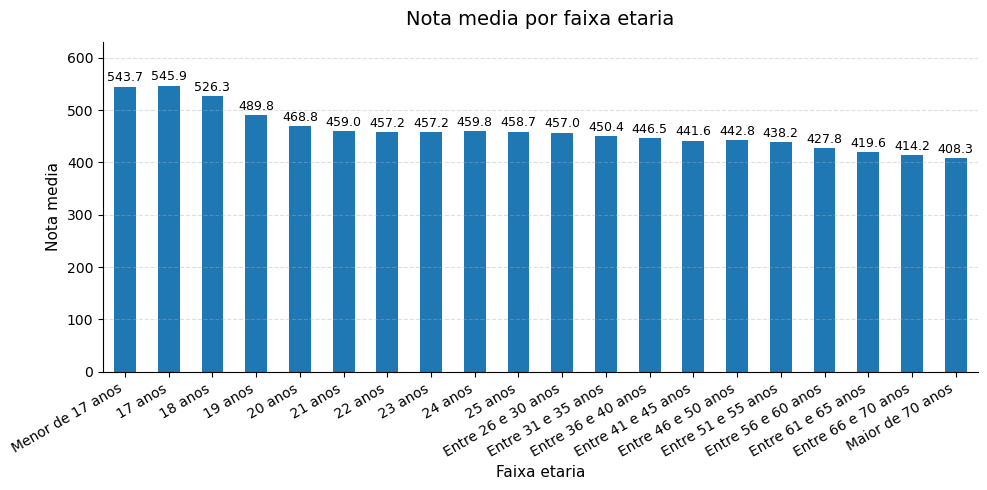

In [59]:
# Cria o grafico
ax = (
     df_plot
        .plot(
            kind='bar',
            y='NU_NOTA_MEDIA',
            figsize=(10, 5),
            legend=False
        )
)

# Titulos e rotulos
ax.set_title('Nota media por faixa etaria', fontsize=14, pad=12)
ax.set_xlabel('Faixa etaria', fontsize=11)
ax.set_ylabel('Nota media', fontsize=11)

# Rotacao e alinhamento do eixo X
plt.xticks(rotation=30, ha='right')

# Grade discreta
ax.grid(axis='y', linestyle='--', alpha=0.4)

# Remover bordas desnecessarias
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Coloca o valor no topo de cada barra
for p in ax.patches:
    ax.annotate(
        f'{p.get_height():.1f}',
        (p.get_x() + p.get_width() / 2, p.get_height() * 1.01 ),
        ha='center',
        va='bottom',
        fontsize=9
    )

# Limite do eixo y
ax.set_ylim(0, ax.get_ylim()[1] * 1.1)

# Ajusta layout e mostra o grafico
plt.tight_layout()
plt.show()

In [60]:
# Resetando coluna de indice, pois as proximas bibliotecas de plot nao enxergam o indice como coluna
df_plot = df_plot.reset_index()

df_plot_tds_notas = df_plot_tds_notas.reset_index()

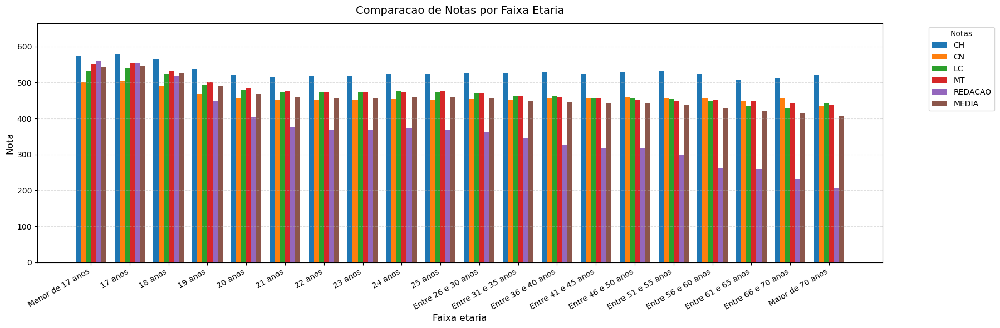

In [61]:
# Tamanho da lista e dataframe
n_notas = len(colunas_notas)
n_idades = len(df_plot_tds_notas)

# Posicao das faixas etarias no eixo x
x = np.arange(n_idades)

# Largura de cada barra
width = 0.13  

# Cria figura
fig, ax = plt.subplots(figsize=(18, 6))

# Plotar cada nota lado a lado
for i, nota in enumerate(colunas_notas):
    ax.bar(
        x + i*width, 
        df_plot_tds_notas[nota],
        width=width,
        label=nota.replace('NU_NOTA_', '')
    )

# Configuracoes do eixo x
ax.set_xticks(x + width*(n_notas-1)/2) 
ax.set_xticklabels(df_plot_tds_notas['descricao_idade'], rotation=30, ha='right')

# Titulo e labels
ax.set_title('Comparacao de Notas por Faixa Etaria', fontsize=14, pad=12)
ax.set_xlabel('Faixa etaria', fontsize=12)
ax.set_ylabel('Nota', fontsize=12)

# Grid
ax.grid(axis='y', linestyle='--', alpha=0.4)

# Legenda
ax.legend(title='Notas', bbox_to_anchor=(1.05, 1), loc='upper left')

"""
# Anotar valores em cima das barras
for i, nota in enumerate(colunas_notas):
    for j, val in enumerate(df_plot_tds_notas[nota]):
        ax.annotate(
            f'{val:.1f}',
            (x[j] + i*width + width/2, val*1.01),
            ha='center',
            va='bottom',
            fontsize=9
        )
"""

# Ajustar limite y
ax.set_ylim(0, df_plot_tds_notas[colunas_notas].max().max()*1.15)

# Ajusta layout e mostra o grafico
plt.tight_layout()
plt.show()

##### Plot Matplotlib

###### Plot de todas as notas por faixa etaria no mesmo grafico

In [62]:
# Resetar indices para tirar coluna do indice, isso eh necessario para usar as proximas bibliotecas
df_plot = df_plot.reset_index() 
df_plot_tds_notas = df_plot_tds_notas.reset_index() 

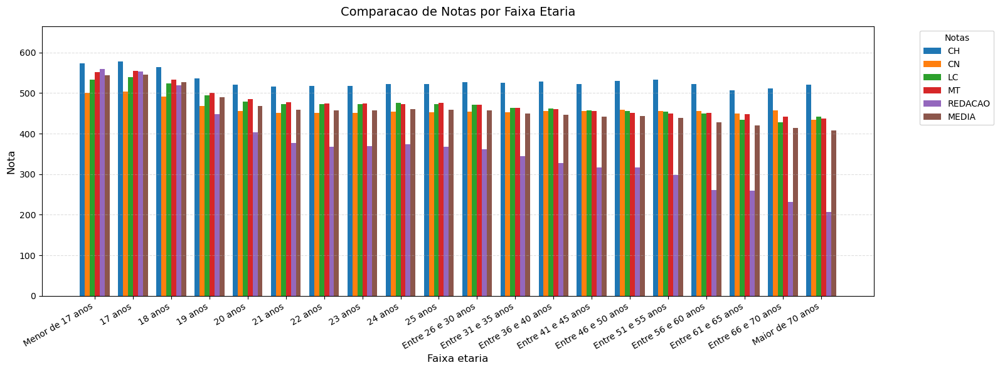

In [63]:
# Tamanho da lista e dataframe
n_notas = len(colunas_notas)
n_idades = len(df_plot_tds_notas)

# Posicao das faixas etarias no eixo x
x = np.arange(n_idades)

# Largura de cada barra
width = 0.13  

fig, ax = plt.subplots(figsize=(16, 6))

# Plotar cada nota lado a lado
for i, nota in enumerate(colunas_notas):
    ax.bar(
        x + i*width,  
        df_plot_tds_notas[nota],
        width=width,
        label=nota.replace('NU_NOTA_', '')
    )

# Configuracoes do eixo x
ax.set_xticks(x + width*(n_notas-1)/2)  
ax.set_xticklabels(df_plot_tds_notas['descricao_idade'], rotation=30, ha='right')

# Titulo e labels
ax.set_title('Comparacao de Notas por Faixa Etaria', fontsize=14, pad=12)
ax.set_xlabel('Faixa etaria', fontsize=12)
ax.set_ylabel('Nota', fontsize=12)

# Grid
ax.grid(axis='y', linestyle='--', alpha=0.4)

# Legenda
ax.legend(title='Notas', bbox_to_anchor=(1.05, 1), loc='upper left')

"""
# Anotar valores em cima das barras
for i, nota in enumerate(colunas_notas):
    for j, val in enumerate(df_plot_tds_notas[nota]):
        ax.annotate(
            f'{val:.1f}',
            (x[j] + i*width + width/2, val*1.01),
            ha='center',
            va='bottom',
        )
"""

# Ajustar limite y
ax.set_ylim(0, df_plot_tds_notas[colunas_notas].max().max()*1.15)

# Ajusta layout e mostra o grafico
plt.tight_layout()
plt.show()

In [64]:
# Colocar todas no mesmo grafico deixa muito pequeno, logo eh melhor fazer subplots

###### Plot em graficos separados das notas

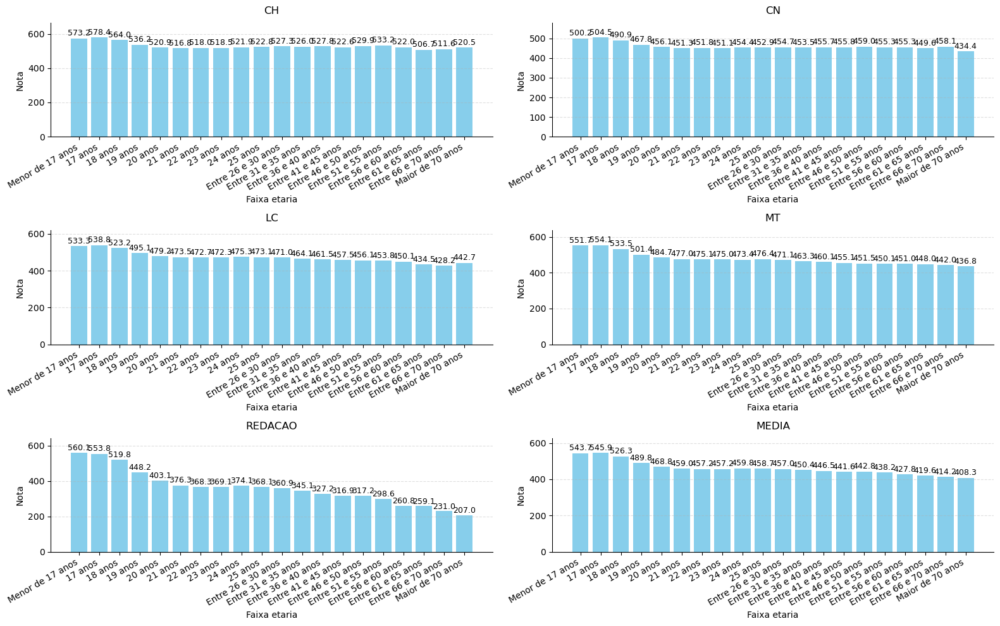

In [65]:
# Numero de subplots necessarios
n_subplots = len(colunas_notas)

# Criar figura 3 linhas x 2 colunas
fig, axes = plt.subplots(3, 2, figsize=(16, 10))
axes = axes.flatten() 

for ax, nota in zip(axes, colunas_notas):
    # Barras
    bars = ax.bar(df_plot_tds_notas['descricao_idade'], df_plot_tds_notas[nota], color='skyblue')

    # Titulo e rotulos
    ax.set_title(nota.replace('NU_NOTA_', '').replace('_', ' '), fontsize=12, pad=10)
    ax.set_xlabel('Faixa etaria', fontsize=10)
    ax.set_ylabel('Nota', fontsize=10)

    # Rotacao do eixo X
    ax.set_xticklabels(df_plot_tds_notas['descricao_idade'], rotation=30, ha='right')

    # Grid discreta
    ax.grid(axis='y', linestyle='--', alpha=0.4)

    # Remover bordas desnecessarias
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    # Anotar valores sobre as barras
    for p in bars:
        ax.annotate(
            f'{p.get_height():.1f}',
            (p.get_x() + p.get_width() / 2, p.get_height() * 1.01),
            ha='center',
            va='bottom',
            fontsize=9
        )

    # Ajustar limite y
    ax.set_ylim(0, df_plot_tds_notas[nota].max() * 1.15)

# Ajusta layout e mostra o grafico
plt.tight_layout()
plt.show()

###### Video das notas medias

In [66]:
# Criar figura 3 linhas x 2 colunas
fig, ax = plt.subplots(figsize=(10, 5))

values = df_plot['NU_NOTA_MEDIA'].values
labels = df_plot['descricao_idade'].values
steps = 30

bars = ax.bar(labels, [0] * len(values))

# Criar textos (comecam em zero)
texts = [
    ax.text(
        bar.get_x() + bar.get_width() / 2,
        0,
        '0.0',
        ha='center',
        va='bottom',
        fontsize=9
    )
    for bar in bars
]

# Limite eixo y
ax.set_ylim(0, values.max() * 1.15)

# Titulo e rotulos
ax.set_title('Nota media por faixa etaria')
ax.set_xlabel('Faixa etaria')
ax.set_ylabel('Nota media')

# Ajusta ticks para inclinar em 30°
plt.xticks(rotation=30, ha='right')
plt.subplots_adjust(bottom=0.30)

# Animacao
def animate(i):
    factor = i / steps

    for bar, text, val in zip(bars, texts, values):
        height = val * factor

        # Atualiza barra
        bar.set_height(height)

        # Atualiza texto
        text.set_text(f'{height:.1f}')
        text.set_y(height * 1.01)

    return list(bars) + texts

# Gera video
ani = FuncAnimation(
    fig,
    animate,
    frames=steps + 1,
    interval=30,
    blit=False,
    repeat=False
)

plt.tight_layout()

# Salvar como MP4 
ani.save(
    'resultados/parciais/nota_media_faixa_etaria.mp4',
    writer=FFMpegWriter(fps=30, bitrate=1800)
)

plt.close()

In [67]:
# Mostra video gerado
HTML("""
<video width="800" controls autoplay>
    <source src="nota_media_faixa_etaria.mp4" type="video/mp4">
</video>
""")

##### Plot do Seaborn

###### Plot da Nota Media

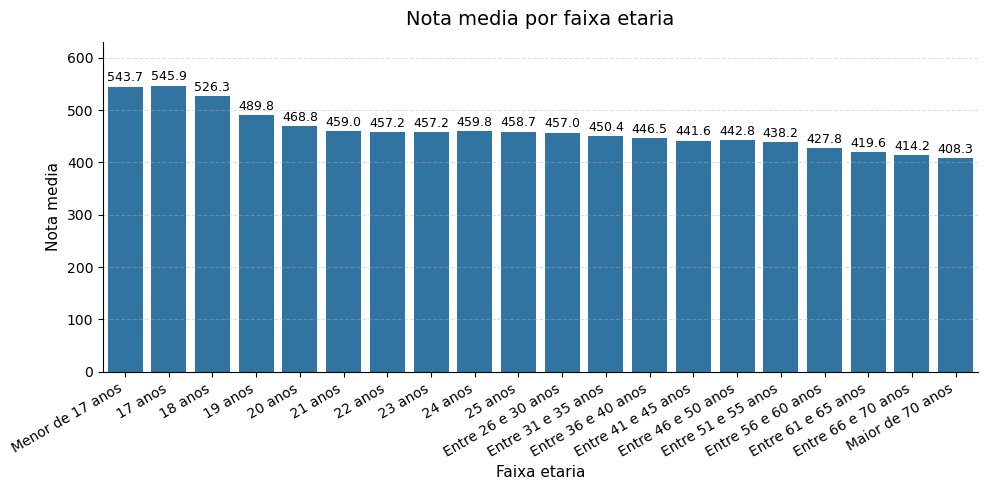

In [68]:
# Gera figura
plt.figure(figsize=(10, 5))

ax = sns.barplot(
    data=df_plot,
    x='descricao_idade',
    y='NU_NOTA_MEDIA',
    errorbar=None
)

# Titulos e rotulos
ax.set_title('Nota media por faixa etaria', fontsize=14, pad=12)
ax.set_xlabel('Faixa etaria', fontsize=11)
ax.set_ylabel('Nota media', fontsize=11)

# Rotacao eixo X
plt.xticks(rotation=30, ha='right')

# Grade discreta
ax.grid(axis='y', linestyle='--', alpha=0.4)

# Remover bordas
sns.despine(ax=ax)

# Valores nas barras
for p in ax.patches:
    ax.annotate(
        f'{p.get_height():.1f}',
        (p.get_x() + p.get_width() / 2, p.get_height() * 1.01),
        ha='center',
        va='bottom',
        fontsize=9
    )

# Ajuste eixo Y
ax.set_ylim(0, ax.get_ylim()[1] * 1.1)

# Ajusta layout e mostra o grafico
plt.tight_layout()
plt.show()

###### Plot de todas as notas por faixa etaria no mesmo grafico

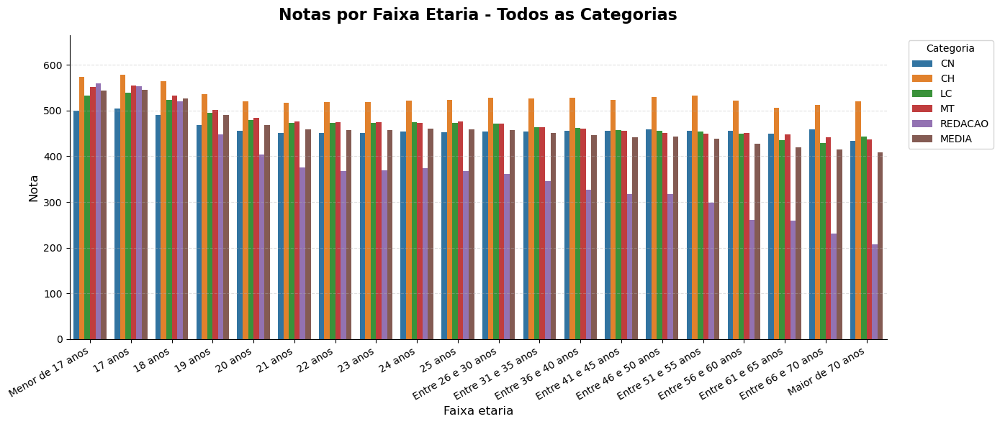

In [69]:
# Transformar o DataFrame para formato “long” (melt) para facilitar Seaborn
df_long = df_plot_tds_notas.melt(
    id_vars='descricao_idade',
    value_vars=['NU_NOTA_CN','NU_NOTA_CH','NU_NOTA_LC','NU_NOTA_MT','NU_NOTA_REDACAO','NU_NOTA_MEDIA'],
    var_name='Categoria',
    value_name='Nota'
)

# Renomear nome das colunas de notas
df_long['Categoria'] = df_long['Categoria'].str.replace('NU_NOTA_', '')

# Criar grafico
plt.figure(figsize=(14,6))
ax = sns.barplot(
    data=df_long,
    x='descricao_idade',
    y='Nota',
    hue='Categoria',  
    palette='tab10',
    errorbar=None
)

# Titulo e rotulos
ax.set_title('Notas por Faixa Etaria - Todos as Categorias', fontsize=16, fontweight='bold', pad=15)
ax.set_xlabel('Faixa etaria', fontsize=12)
ax.set_ylabel('Nota', fontsize=12)

# Rotacao eixo X
plt.xticks(rotation=30, ha='right')

# Grid discreta
ax.grid(axis='y', linestyle='--', alpha=0.4)

# Remover bordas
sns.despine(ax=ax)


"""
# Valores sobre as barras
for p in ax.patches:
    height = p.get_height()
    ax.annotate(
        f'{height:.1f}',
        (p.get_x() + p.get_width() / 2, height * 1.01),
        ha='center',
        va='bottom',
        fontsize=9
    )
"""

# Ajuste limite y
ax.set_ylim(0, df_long['Nota'].max()*1.15)

# Legenda fora do grafico
ax.legend(title='Categoria', bbox_to_anchor=(1.02,1), loc='upper left')

# Ajusta layout e mostra o grafico
plt.tight_layout()
plt.show()

###### Plot em graficos separados das notas

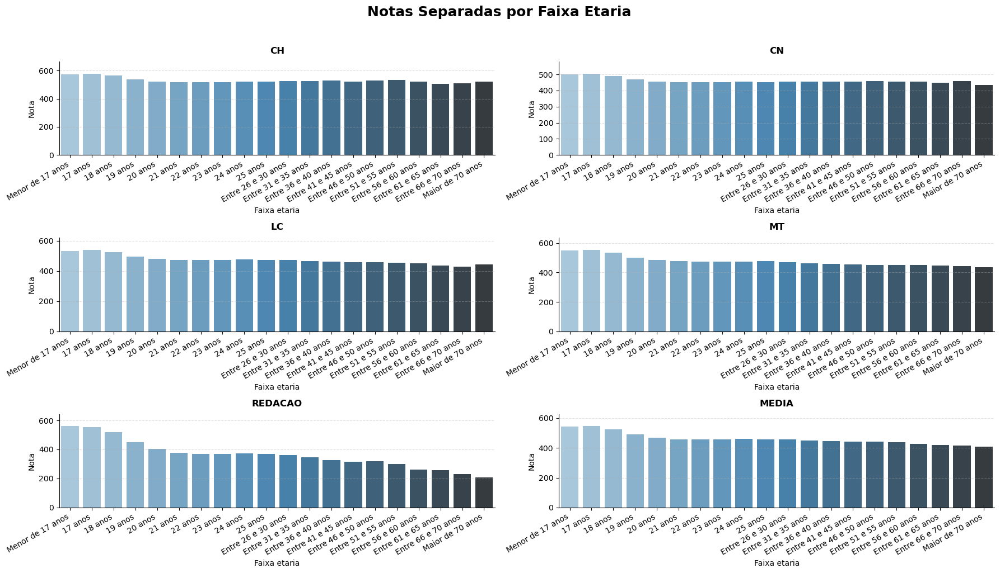

In [70]:
# Numero de subplots necessarios
n_subplots = len(colunas_notas)

# Criar figura 2 linhas x 3 colunas
fig, axes = plt.subplots(3, 2, figsize=(18, 10))
axes = axes.flatten()  

# Titulo geral da figura
fig.suptitle('Notas Separadas por Faixa Etaria', fontsize=18, y=1.02, fontweight = 'bold')

# Gera o grafico
for ax, nota in zip(axes, colunas_notas):
    # Plot Seaborn
    sns.barplot(
        data=df_plot_tds_notas,
        x='descricao_idade',
        y=nota,
        ax=ax,
        palette="Blues_d",
        errorbar=None
    )

    # Titulo e labels
    ax.set_title(nota.replace('NU_NOTA_', '').replace('_', ' '), fontsize=12, pad=10, fontweight = 'bold')
    ax.set_xlabel('Faixa etaria', fontsize=10)
    ax.set_ylabel('Nota', fontsize=10)

    # Rotacao eixo X
    ax.set_xticklabels(df_plot_tds_notas['descricao_idade'], rotation=30, ha='right')

    # Grid discreta
    ax.grid(axis='y', linestyle='--', alpha=0.4)

    # Remover bordas
    sns.despine(ax=ax)

    """
    # Valores nas barras
    for p in ax.patches:
        ax.annotate(
            f'{p.get_height():.1f}',
            (p.get_x() + p.get_width() / 2, p.get_height() * 1.01),
            ha='center',
            va='bottom',
            fontsize=9
        )
    """
        
    # Ajuste eixo Y
    ax.set_ylim(0, df_plot_tds_notas[nota].max() * 1.15)

# Ajusta layout e mostra o grafico
plt.tight_layout()
plt.show()

##### Plotly

###### Plot da Nota Media

In [71]:
# Media geral
media_geral = media_notas_por_materia['NU_NOTA_MEDIA']

# Cores condicionais
def cor_barra(valor):
    if valor < media_geral:
        return 'tomato'         
    elif valor >= media_geral:
        return 'seagreen'  
    else:
        return 'grey'          

cores = df_plot['NU_NOTA_MEDIA'].apply(cor_barra)

# Criar figura
fig = go.Figure(
    data=[
        go.Bar(
            x=df_plot['descricao_idade'],
            y=df_plot['NU_NOTA_MEDIA'],
            text=[f"<b>{val:.1f}</b>" for val in df_plot['NU_NOTA_MEDIA']],  
            textposition='outside',
            marker_color=cores,
            hovertemplate=[
                f"<b>{faixa}</b><br>Nota: {nota:.1f}<br>{'acima' if nota>media_geral else 'abaixo' if nota<media_geral else 'na media'} da media ({media_geral:.1f})"
                for faixa, nota in zip(df_plot['descricao_idade'], df_plot['NU_NOTA_MEDIA'])
            ]
        )
    ]
)

# Linha de referencia da media (mais transparente)
fig.add_shape(
    type="line",
    x0=-0.5,
    x1=len(df_plot['descricao_idade'])-0.5,
    y0=media_geral,
    y1=media_geral,
    line=dict(color="black", dash="dash", width=2), 
    opacity=0.5
)

# Anotacao da media
fig.add_annotation(
    x=len(df_plot['descricao_idade']) - 0.5,
    y=media_geral,
    text=f"<b>Media geral: {media_geral:.1f}</b>",
    showarrow=False,
    xanchor='left',
    yanchor='bottom',
    font=dict(size=12, color='black', weight = 'bold')
)

# Layout
fig.update_layout(
    title=dict(
        text="<b>Nota media por faixa etaria</b>",
        x=0.5,
        xanchor='center'
    ),
    xaxis_title='Faixa etaria',
    yaxis_title='Nota media',
    yaxis=dict(range=[0, df_plot['NU_NOTA_MEDIA'].max() * 1.15]),
    xaxis_tickangle=-30,
    template='plotly_white'
)

fig.show()

In [72]:
# Salvando em html
fig.write_html(
    'resultados/parciais/nota_media_faixa_etaria_interativo.html', 
    include_plotlyjs='cdn',                
    full_html=True,                        
    auto_open=False                          
)

###### Plot em graficos separados das notas, interativo com botoes

In [73]:
# Paleta discreta para as notas
paleta = pc.qualitative.Plotly

# Funcao de cor condicional
def cor_barra(valor, media):
    if valor < media:
        return 'tomato'
    elif valor > media:
        return 'seagreen'
    else:
        return 'lightgrey'

# Criar figura
fig = go.Figure()

# Adicionar cada nota como trace, inicialmente todas visiveis
for i, nota in enumerate(colunas_notas):
    valores = df_plot_tds_notas[nota]
    
    # Para o estado "Todas", usar cores da paleta
    cores = [paleta[i % len(paleta)]] * len(valores)
    
    fig.add_trace(
        go.Bar(
            x=df_plot_tds_notas['descricao_idade'],
            y=valores,
            name=nota.replace('NU_NOTA_', ''),
            text=[f"<b>{v:.1f}</b>" for v in valores],
            textposition='outside',
            marker_color=cores,
            visible=True
        )
    )

# Botoes
buttons = []

# Botao "Todas"
buttons.append(dict(
    label="Todas",
    method='update',
    args=[
        {
            'visible': [True]*len(colunas_notas),
            # Cada trace com sua cor da paleta
            'marker.color': [[paleta[i % len(paleta)]]*len(df_plot_tds_notas) for i in range(len(colunas_notas))],
            # Hover simplificado, apenas faixa e nota
            'hovertemplate': [
                [f"<b>{faixa}</b><br>Nota: {v:.1f}" 
                 for faixa, v in zip(df_plot_tds_notas['descricao_idade'], df_plot_tds_notas[colunas_notas[i]])]
                for i in range(len(colunas_notas))
            ]
        },
        {
            'title': "<b>Todas as Notas por Faixa Etaria</b>",
            'shapes': [],
            'annotations': []
        }
    ]
))

# Botoes individuais
for i, nota in enumerate(colunas_notas):
    valores = df_plot_tds_notas[nota]
    media = media_notas_por_materia[nota]
    visible = [False]*len(colunas_notas)
    visible[i] = True
    
    # Linha de media e anotacao
    shape = [dict(
        type="line",
        x0=-0.5,
        x1=len(df_plot_tds_notas['descricao_idade'])-0.5,
        y0=media,
        y1=media,
        line=dict(color="black", dash="dash", width=2, weight = 'bold'),
        opacity=0.5
    )]
    annotation = [dict(
        x=len(df_plot_tds_notas['descricao_idade']) - 0.5,
        y=media,
        text=f"<b>Media: {media:.1f}</b>",
        showarrow=False,
        xanchor='left',
        yanchor='bottom',
        font=dict(size=12, color='black', weight = 'bold')
    )]
    
    # Cores condicionais
    cores_condicionais = [cor_barra(v, media) for v in valores]
    
    # Hover completo
    hover_text = [
        f"<b>{faixa}</b><br>Nota: {v:.1f}<br>"
        f"{'acima da media' if v>media else 'abaixo da media' if v<media else 'na media'} ({media:.1f})"
        for faixa, v in zip(df_plot_tds_notas['descricao_idade'], valores)
    ]
    
    buttons.append(dict(
        label=nota.replace('NU_NOTA_', ''),
        method='update',
        args=[
            {'visible': visible,
             'marker.color': [cores_condicionais],
             'hovertemplate': [hover_text]},
            {'title': f"<b>{nota.replace('NU_NOTA_', 'Nota ')} por Faixa Etaria</b>",
             'shapes': shape,
             'annotations': annotation}
        ]
    ))

# Layout
fig.update_layout(
    title=dict(text="<b>Todas as Notas por Faixa Etaria</b>", x=0.5, xanchor='center'),
    xaxis_title="Faixa etaria",
    yaxis_title="Nota",
    yaxis=dict(range=[0, df_plot_tds_notas[colunas_notas].max().max() * 1.15]),
    barmode='group',
    xaxis_tickangle=-30,
    legend_title_text='Componente',
    template='plotly_white',
    updatemenus=[dict(
        type='buttons',
        buttons=buttons,
        direction='down',
        showactive=True,
        x=-0.25,    
        y=0.5,
        xanchor='left',
        yanchor='middle'
    )]
)

fig.show()

In [74]:
# Salvando em html
fig.write_html(
    'resultados/parciais/notas_faixa_etaria_interativo.html',  
    include_plotlyjs='cdn',                
    full_html=True,                        
    auto_open=False                         
)

###### Animacao Interativa Nota Media

In [75]:
values = df_plot['NU_NOTA_MEDIA'].values
labels = df_plot['descricao_idade'].values

max_y = values.max()
steps = 60

frames = []

for i in range(steps + 1):
    factor = i / steps
    y_vals = values * factor

    frames.append(
        go.Frame(
            data=[
                go.Bar(
                    x=labels,
                    y=y_vals,
                    text=[f'{v:.1f}' for v in y_vals],  
                    textposition='outside'
                )
            ]
        )
    )

fig = go.Figure(
    data=[
        go.Bar(
            x=labels,
            y=[0] * len(values),
            text=['0.0'] * len(values),
            textposition='outside'
        )
    ],
    frames=frames
)

fig.update_layout(
    title=dict(
        text='<b><u>Nota media por Faixa Etaria</u></b>',
        x=0.5,
        xanchor='center'
    ),
    xaxis_title='Faixa etaria',
    yaxis_title='Nota media',
    yaxis_range=[0, max_y * 1.2],
    xaxis_tickangle=-30,
    updatemenus=[
        dict(
            type='buttons',
            showactive=False,
            x=-0.05,
            y=1.4,
            buttons=[
                dict(
                    label='▶ Play',
                    method='animate',
                    args=[None, {
                        "frame": {"duration": 30},
                        "fromcurrent": True
                    }],
                    
                ),
                dict(
                    label="⏸ Pause",
                    method="animate",
                    args=[[None], {"frame": {"duration": 0, "redraw": True},
                                   "mode": "immediate",
                                   "transition": {"duration":0}}]
                )
            ]
        )

    ]
)

fig.show()

In [76]:
# Salvando em html
fig.write_html(
    'resultados/parciais/nota_media_faixa_etaria_interativo_animado.html', 
    include_plotlyjs='cdn',                
    full_html=True,                         
    auto_open=False                          
)

###### Animacao Interativa todas as notas

In [77]:
# Paleta de cores para utilizar
paleta = ['#636EFA', '#EF553B', '#00CC96', '#AB63FA', '#FFA15A', '#19D3F3']

# Steps e duracao da animacao
steps = 30
duration = 30

# Limite eixo y
max_y = df_plot_tds_notas[colunas_notas].max().max() * 1.15

# Funcao de cor condicional
def cor_barra(valor, media):
    if valor < media:
        return 'tomato'
    elif valor > media:
        return 'seagreen'
    else:
        return 'lightgreen'

fig = go.Figure()

# Traces iniciais (invisiveis)
for i, nota in enumerate(colunas_notas):
    fig.add_trace(go.Bar(
        x=df_plot_tds_notas['descricao_idade'],
        y=[0]*len(df_plot_tds_notas),
        text=[0]*len(df_plot_tds_notas),
        textposition='outside',
        marker_color=[paleta[i]]*len(df_plot_tds_notas),
        visible=True,
        name=nota.replace('NU_NOTA_', '')
    ))

# Frames individuais para cada nota
frames_dict = {}
for i, nota in enumerate(colunas_notas):
    y_values = df_plot_tds_notas[nota].values
    media = media_notas_por_materia[nota]
    frames = []
    title_nota = f"<b>{nota.replace('NU_NOTA_', 'Nota ')} por Faixa Etaria</b>"

    # Hover fixo usando y_values real
    hover_text = [
        f"<b>{faixa}</b><br>Nota: {v:.1f}<br>"
        f"{'acima da media' if v>media else 'abaixo da media' if v<media else 'na media'} ({media:.1f})"
        for faixa, v in zip(df_plot_tds_notas['descricao_idade'], y_values)
    ]

    # Frames da barra subindo
    for step in range(steps + 1):
        fraction = step / steps
        y_step = np.round(y_values * fraction, 1)
        data_frames = []
        for j in range(len(colunas_notas)):
            if j == i:
                data_frames.append(go.Bar(
                    x=df_plot_tds_notas['descricao_idade'],
                    y=y_step,
                    text=[f"<b>{v:.1f}</b>" for v in y_step],
                    textposition='outside',
                    marker_color=[cor_barra(v, media) for v in y_step],
                    hovertemplate=hover_text,
                    visible=True
                ))
            else:
                data_frames.append(go.Bar(
                    x=df_plot_tds_notas['descricao_idade'],
                    y=[0]*len(df_plot_tds_notas),
                    visible=False
                ))

        # Linha da media fixa 
        shape = [dict(
            type="line",
            x0=-0.5, x1=len(df_plot_tds_notas['descricao_idade'])-0.5,
            y0=media, y1=media,
            line=dict(color="black", dash="dash", width=2),
            opacity=0.5
        )]
        annotation = [dict(
            x=len(df_plot_tds_notas['descricao_idade']) - 0.5,
            y=media,
            text=f"<b>Media: {media:.1f}</b>",
            showarrow=False,
            xanchor='left',
            yanchor='bottom',
            font=dict(size=12, color='black', weight = 'bold'),
            opacity=1
        )]

        frames.append(go.Frame(
            data=data_frames,
            layout=dict(
                title=dict(text=title_nota, x=0.5, xanchor='center'),
                yaxis=dict(range=[0, max_y]),
                shapes=shape,
                annotations=annotation
            )
        ))
    frames_dict[nota] = frames

# Frames para "Todas" 
frames_todas = []
title_todas = "<b>Todas as Notas por Faixa Etaria</b>"
y_values_all = df_plot_tds_notas[colunas_notas].values.T
for step in range(steps + 1):
    fraction = step / steps
    data_frames = []
    for i, nota in enumerate(colunas_notas):
        y_step = np.round(y_values_all[i] * fraction, 1)
        data_frames.append(go.Bar(
            x=df_plot_tds_notas['descricao_idade'],
            y=y_step,
            text=[f"<b>{v:.1f}</b>" for v in y_step],
            textposition='outside',
            marker_color=[paleta[i]]*len(y_step),
            visible=True,
            hovertemplate=[f"<b>{faixa}</b><br>Nota: {v:.1f}"
                           for faixa, v in zip(df_plot_tds_notas['descricao_idade'], y_step)]
        ))
    frames_todas.append(go.Frame(
        data=data_frames,
        layout=dict(
            title=dict(text=title_todas, x=0.5, xanchor='center'),
            yaxis=dict(range=[0, max_y]),
            shapes= [dict(opacity=0)],
            annotations = [dict(text='', opacity=0)] 
        )
    ))

# Botoes
buttons = [dict(
    label="Todas",
    method="animate",
    args=[frames_todas,
          dict(frame=dict(duration=duration, redraw=True),
               fromcurrent=True, mode='immediate')]
)]
for nota in colunas_notas:
    buttons.append(dict(
        label=nota.replace('NU_NOTA_', ''),
        method="animate",
        args=[frames_dict[nota],
              dict(frame=dict(duration=duration, redraw=True),
                   fromcurrent=True, mode='immediate')]
    ))

# Layout final
fig.update_layout(
    title=dict(text=title_todas, x=0.5, xanchor='center'),
    xaxis_title="Faixa etaria",
    yaxis_title="Nota",
    yaxis=dict(range=[0, max_y]),
    barmode='group',
    xaxis_tickangle=-30,
    legend_title_text='Categoria',
    template='plotly_white',
    updatemenus=[dict(
        type='buttons',
        buttons=buttons,
        direction='down',
        showactive=True,
        x=-0.25,
        y=0.5,
        xanchor='left',
        yanchor='middle'
    )]
)

fig.show()

In [78]:
# Salvando em html
fig.write_html(
    'resultados/parciais/notas_faixa_etaria_interativo_animado.html',  
    include_plotlyjs='cdn',               
    full_html=True,                       
    auto_open=False,                       
    auto_play = False
)

#### Sexo

In [79]:
# Preapando dados para plot
df_plot_tds_notas = (
    dados_consolidados
        .sort_values(by='TP_SEXO')
        .filter(items=['TP_SEXO', 'NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA'])
        .groupby('TP_SEXO', sort=False)
        .mean()
)

In [80]:
# Resetar indices para tirar coluna do indice, isso eh necessario para usar as proximas bibliotecas
df_plot_tds_notas = df_plot_tds_notas.reset_index() 

##### Dumbbell chart

In [81]:
# Criando Label por categoria
labels = [n.replace('NU_NOTA_', '') for n in colunas_notas]

# Dataframe sexo Feminino
df_f = (
    df_plot_tds_notas
    .where(df_plot_tds_notas['TP_SEXO'] == 'F')
    .dropna(subset=['TP_SEXO'])
)

# Dataframe sexo Masculino
df_m = (
    df_plot_tds_notas
    .where(df_plot_tds_notas['TP_SEXO'] == 'M')
    .dropna(subset=['TP_SEXO'])
)

# Medias por categoria
val_f = [df_f[n].mean() for n in colunas_notas]
val_m = [df_m[n].mean() for n in colunas_notas]

fig = go.Figure()

# Linhas conectando F ↔ M
for y, f, m in zip(labels, val_f, val_m):
    fig.add_trace(go.Scatter(
        x=[f, m],
        y=[y, y],
        mode='lines',
        line=dict(color='lightgray', width=3),
        showlegend=False,
        hoverinfo='skip'
    ))

# Pontos Feminino
fig.add_trace(go.Scatter(
    x=val_f,
    y=labels,
    mode='markers',
    name='Feminino',
    marker=dict(size=12, color='lightcoral'),
    hovertemplate="<b>Feminino</b><br>Nota: %{x:.1f}"
))

# Pontos Masculino
fig.add_trace(go.Scatter(
    x=val_m,
    y=labels,
    mode='markers',
    name='Masculino',
    marker=dict(size=12, color='steelblue'),
    hovertemplate="<b>Masculino</b><br>Nota: %{x:.1f}"
))

# Layout final
fig.update_layout(
    title=dict(
        text="<b>Comparacao das Notas por Sexo</b>",
        x=0.5
    ),
    xaxis=dict(title="Nota"),
    yaxis=dict(title=""),
    template='plotly_white',
    legend=dict(orientation='h', y=-0.5, xanchor='center', x = 0.5),
)

fig.show()

In [82]:
# Salvando em html
fig.write_html(
    'resultados/parciais/notas_sexo_dumbbell.html',  
    include_plotlyjs='cdn',                
    full_html=True,                         
    auto_open=False                         
)

##### Plot em graficos separados das notas, interativo com botoes

In [83]:
# Colocar descricao do sexo em vez da sigla
map_sexo = {
    'F': 'Feminino',
    'M': 'Masculino'
}

df_plot_tds_notas['TP_SEXO_DESC'] = df_plot_tds_notas['TP_SEXO'].map(map_sexo)

# Paleta discreta para as notas
paleta = pc.qualitative.Plotly

# Paleta discreta para as notas
paleta_sexo = ['lightcoral', 'steelblue']

# Criar figura
fig = go.Figure()

# Adicionar cada nota como trace, inicialmente todas visiveis
for i, nota in enumerate(colunas_notas):
    valores = df_plot_tds_notas[nota]
    
    # Para o estado "Todas", usar cores da paleta
    cores = [paleta[i % len(paleta)]] * len(valores)
    
    fig.add_trace(
        go.Bar(
            x=df_plot_tds_notas['TP_SEXO_DESC'],
            y=valores,
            name=nota.replace('NU_NOTA_', ''),
            text=[f"<b>{v:.1f}</b>" for v in valores],
            textposition='outside',
            marker_color=cores,
            visible=True
        )
    )

# Botoes
buttons = []

# Botao "Todas"
buttons.append(dict(
    label="Todas",
    method='update',
    args=[
        {
            'visible': [True]*len(colunas_notas),
            # Cada trace com sua cor da paleta
            'marker.color': [[paleta[i % len(paleta)]]*len(df_plot_tds_notas) for i in range(len(colunas_notas))],
            # Hover simplificado, apenas sexo e nota
            'hovertemplate': [
                [f"<b> {sexo}</b><br>Nota: {v:.1f}" 
                 for sexo, v in zip(df_plot_tds_notas['TP_SEXO_DESC'], df_plot_tds_notas[colunas_notas[i]])]
                for i in range(len(colunas_notas))
            ]
        },
        {
            'title': "<b>Todas as Notas por Sexo</b>",
            'shapes': [],
            'annotations': []
        }
    ]
))

# Botoes individuais
for i, nota in enumerate(colunas_notas):
    valores = df_plot_tds_notas[nota]
    media = valores.mean()
    visible = [False]*len(colunas_notas)
    visible[i] = True  
             
    # Hover completo
    hover_text = [
        f"<b>{sexo}</b><br>Nota: {v:.1f}<br>"
        for sexo, v in zip(df_plot_tds_notas['TP_SEXO_DESC'], valores)
    ]
    
    buttons.append(dict(
        label=nota.replace('NU_NOTA_', ''),
        method='update',
        args=[
            {'visible': visible,
             'marker.color': [paleta_sexo],
             'hovertemplate': [hover_text]},
            {'title': f"<b>{nota.replace('NU_NOTA_', 'Nota ')} por Sexo</b>",
             'shapes': [],
             'annotations': []}
        ]
    ))

# Layout final
fig.update_layout(
    title=dict(text="<b>Todas as Notas por Sexo</b>", x=0.5, xanchor='center'),
    xaxis=dict(
        title="Sexo",
        ticks="outside",
        tickfont=dict(size=12, weight = 1000)
    ),
    yaxis=dict(
        title="Nota",
        range=[0, df_plot_tds_notas[colunas_notas].max().max() * 1.15]
    ),
    barmode='group',
    legend_title_text='Categoria',
    template='plotly_white',
    updatemenus=[dict(
        type='buttons',
        buttons=buttons,
        direction='down',
        showactive=True,
        x=-0.25,   
        y=0.5,
        xanchor='left',
        yanchor='middle',
    )]
)

fig.show()

In [84]:
# Salvando em html
fig.write_html(
    'resultados/parciais/notas_sexo_interativo.html', 
    include_plotlyjs='cdn',               
    full_html=True,                         
    auto_open=False,
    auto_play = False
)

##### Animacao Interativa todas as notas

In [85]:
df_plot_tds_notas['TP_SEXO_DESC'] = df_plot_tds_notas['TP_SEXO'].map(map_sexo)

# Paleta discreta para as notas
#paleta = ['#636EFA', '#EF553B', '#00CC96', '#AB63FA', '#FFA15A', '#19D3F3']
paleta = pc.qualitative.Plotly

# Paleta discreta para as notas
paleta_sexo = ['lightcoral', 'steelblue']

steps = 30
duration = 20
max_y = df_plot_tds_notas[colunas_notas].max().max() * 1.15

fig = go.Figure()

# Traces iniciais (invisiveis)
for i, nota in enumerate(colunas_notas):
    fig.add_trace(go.Bar(
        x=df_plot_tds_notas['TP_SEXO_DESC'],
        y=[0]*len(df_plot_tds_notas),
        text=[0]*len(df_plot_tds_notas),
        textposition='outside',
        marker_color=[paleta[i]]*len(df_plot_tds_notas),
        visible=True,
        name=nota.replace('NU_NOTA_', '')
    ))

# Frames individuais para cada nota
frames_dict = {}
for i, nota in enumerate(colunas_notas):
    y_values = df_plot_tds_notas[nota].values
    frames = []
    title_nota = f"<b>{nota.replace('NU_NOTA_', 'Nota ')} por Sexo</b>"

    # Hover fixo usando y_values real
    hover_text = [
        f"<b>{sexo}</b><br>Nota: {v:.1f}<br>"
        for sexo, v in zip(df_plot_tds_notas['TP_SEXO_DESC'], y_values)
    ]

    for step in range(steps + 1):
        fraction = step / steps
        y_step = np.round(y_values * fraction, 1)
        data_frames = []
        for j in range(len(colunas_notas)):
            if j == i:
                data_frames.append(go.Bar(
                    x=df_plot_tds_notas['TP_SEXO_DESC'],
                    y=y_step,
                    text=[f"<b>{v:.1f}</b>" for v in y_step],
                    textposition='outside',
                    marker_color=paleta_sexo,
                    hovertemplate=hover_text,
                    visible=True
                ))
            else:
                data_frames.append(go.Bar(
                    x=df_plot_tds_notas['TP_SEXO_DESC'],
                    y=[0]*len(df_plot_tds_notas),
                    visible=False
                ))
        
        frames.append(go.Frame(
            data=data_frames,
            layout=dict(
                title=dict(text=title_nota, x=0.5, xanchor='center'),
                yaxis=dict(range=[0, max_y]),
                shapes=[],
                annotations=[]
            )
        ))
    frames_dict[nota] = frames

# Frames para "Todas" 
frames_todas = []
title_todas = "<b>Todas as Notas por Sexo</b>"
y_values_all = df_plot_tds_notas[colunas_notas].values.T
for step in range(steps + 1):
    fraction = step / steps
    data_frames = []
    for i, nota in enumerate(colunas_notas):
        y_step = np.round(y_values_all[i] * fraction, 1)
        data_frames.append(go.Bar(
            x=df_plot_tds_notas['TP_SEXO_DESC'],
            y=y_step,
            text=[f"<b>{v:.1f}</b>" for v in y_step],
            textposition='outside',
            marker_color=[paleta[i]]*len(y_step),
            visible=True,
            hovertemplate=[f"<b>{sexo}</b><br>Nota: {v:.1f}"
                           for sexo, v in zip(df_plot_tds_notas['TP_SEXO_DESC'], y_step)]
        ))
    frames_todas.append(go.Frame(
        data=data_frames,
        layout=dict(
            title=dict(text=title_todas, x=0.5, xanchor='center'),
            yaxis=dict(range=[0, max_y]),
            shapes= [],
            annotations = []
        )
    ))

# Botoes
buttons = [dict(
    label="Todas",
    method="animate",
    args=[frames_todas,
          dict(frame=dict(duration=duration, redraw=True),
               fromcurrent=True, mode='immediate')]
)]
for nota in colunas_notas:
    buttons.append(dict(
        label=nota.replace('NU_NOTA_', ''),
        method="animate",
        args=[frames_dict[nota],
              dict(frame=dict(duration=duration, redraw=True),
                   fromcurrent=True, mode='immediate')]
    ))

# Layout final
fig.update_layout(
    title=dict(text=title_todas, x=0.5, xanchor='center'),
    xaxis=dict(
        title="Sexo",
        ticks="outside",
        tickfont=dict(size=12, weight = 1000)
    ),
    yaxis=dict(
        title="Nota",
        range=[0, max_y]
    ),
    barmode='group',
    legend_title_text='Categoria',
    template='plotly_white',
    updatemenus=[dict(
        type='buttons',
        buttons=buttons,
        direction='down',
        showactive=True,
        x=-0.25,
        y=0.5,
        xanchor='left',
        yanchor='middle'
    )]
)

fig.show()

In [86]:
# Salvando em html
fig.write_html(
    'resultados/parciais/notas_sexo_interativo_animado.html',  
    include_plotlyjs='cdn',               
    full_html=True,                         
    auto_open=False,
    auto_play = False
)

#### Escolaridade

In [87]:
# Preapando dados para plot
df_plot_tds_notas = (
    dados_consolidados
        .sort_values(by='TP_ESCOLA')
        .filter(items=['descricao_escola', 'NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA'])
        .groupby('descricao_escola', sort=False)
        .mean()
)

In [88]:
# Resetar indices para tirar coluna do indice, isso eh necessario para usar as proximas bibliotecas
df_plot_tds_notas = df_plot_tds_notas.reset_index() 

##### Plot em graficos separados das notas, interativo com botoes 

In [89]:
# Paleta discreta para as notas
paleta = pc.qualitative.Plotly

# Funcao de cor condicional
def cor_barra(valor, media):
    if valor < media:
        return 'tomato'
    elif valor >= media:
        return 'seagreen'
    else:
        return 'grey'

# Criar figura
fig = go.Figure()

# Adicionar cada nota como trace, inicialmente todas visiveis
for i, nota in enumerate(colunas_notas):
    valores = df_plot_tds_notas[nota]
    
    # Para o estado "Todas", usar cores da paleta
    cores = [paleta[i % len(paleta)]] * len(valores)
    
    fig.add_trace(
        go.Bar(
            x=df_plot_tds_notas['descricao_escola'],
            y=valores,
            name=nota.replace('NU_NOTA_', ''),
            text=[f"<b>{v:.1f}</b>" for v in valores],
            textposition='outside',
            marker_color=cores,
            visible=True
        )
    )

# Botoes
buttons = []

# Botao "Todas"
buttons.append(dict(
    label="Todas",
    method='update',
    args=[
        {
            'visible': [True]*len(colunas_notas),
            # Cada trace com sua cor da paleta
            'marker.color': [[paleta[i % len(paleta)]]*len(df_plot_tds_notas) for i in range(len(colunas_notas))],
            # Hover simplificado, apenas escolaridade e nota
            'hovertemplate': [
                [f"<b>{escolaridade}</b><br>Nota: {v:.1f}<extra></extra" 
                 for escolaridade, v in zip(df_plot_tds_notas['descricao_escola'], df_plot_tds_notas[colunas_notas[i]])]
                for i in range(len(colunas_notas))
            ]
        },
        {
            'title': "<b>Todas as Notas por Escolaridade</b>",
            'shapes': [],
            'annotations': []
        }
    ]
))

# Botoes individuais
for i, nota in enumerate(colunas_notas):
    valores = df_plot_tds_notas[nota]
    media = media_notas_por_materia[nota]
    visible = [False]*len(colunas_notas)
    visible[i] = True
    
    # Linha de media e anotacao
    shape = [dict(
        type="line",
        x0=-0.5,
        x1=len(df_plot_tds_notas['descricao_escola'])-0.5,
        y0=media,
        y1=media,
        line=dict(color="black", dash="dash", width=2, weight = 'bold'),
        opacity=0.5
    )]
    annotation = [dict(
        x=len(df_plot_tds_notas['descricao_escola']) - 0.5,
        y=media,
        text=f"<b>Media: {media:.1f}</b>",
        showarrow=False,
        xanchor='left',
        yanchor='bottom',
        font=dict(size=12, color='black', weight = 'bold')
    )]
    
    # Cores condicionais
    cores_condicionais = [cor_barra(v, media) for v in valores]
    
    # Hover completo
    hover_text = [
        f"<b>{escolaridade}</b><br>Nota: {v:.1f}<br>"
        f"{'acima da media' if v>media else 'abaixo da media' if v<media else 'na media'} ({media:.1f})"
        for escolaridade, v in zip(df_plot_tds_notas['descricao_escola'], valores)
    ]
    
    buttons.append(dict(
        label=nota.replace('NU_NOTA_', ''),
        method='update',
        args=[
            {'visible': visible,
             'marker.color': [cores_condicionais],
             'hovertemplate': [hover_text]},
            {'title': f"<b>{nota.replace('NU_NOTA_', 'Nota ')} por Escolaridade</b>",
             'shapes': shape,
             'annotations': annotation}
        ]
    ))

# Layout
fig.update_layout(
    title=dict(text="<b>Todas as Notas por Escolaridade</b>", x=0.5, xanchor='center'),
    xaxis=dict(
        title="Escolaridade",
        ticks="outside",
        tickfont=dict(size=12, weight = 1000),
        tickangle=-30
    ),
    yaxis=dict(
        title="Nota",
        range=[0, df_plot_tds_notas[colunas_notas].max().max() * 1.15]
    ),
    
    barmode='group',
    legend_title_text='Categoria',
    template='plotly_white',
    updatemenus=[dict(
        type='buttons',
        buttons=buttons,
        direction='down',
        showactive=True,
        x=-0.25,  
        y=0.5,
        xanchor='left',
        yanchor='middle'
    )]
)

fig.show()

In [90]:
# Salvando em html
fig.write_html(
    'resultados/parciais/notas_escolaridade_interativo.html',  
    include_plotlyjs='cdn',                
    full_html=True,                      
    auto_open=False,
    auto_play = False
)

##### Animacao Interativa todas as notas

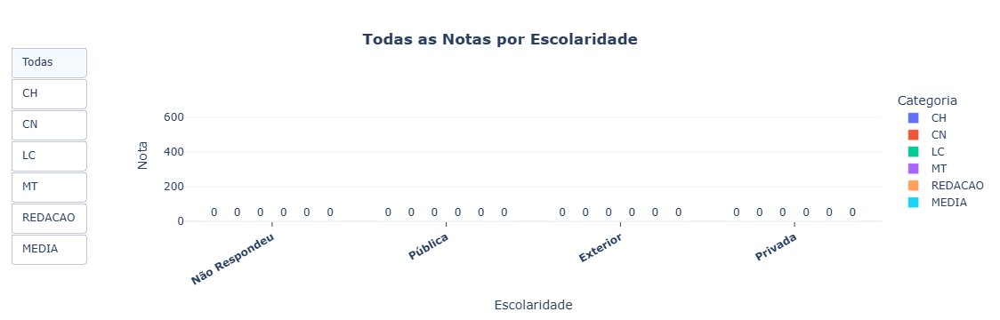

In [91]:
# Paleta de cores para utilizar
paleta = ['#636EFA', '#EF553B', '#00CC96', '#AB63FA', '#FFA15A', '#19D3F3']

# Steps e duracao da animacao
steps = 30
duration = 30

# Limite eixo y
max_y = df_plot_tds_notas[colunas_notas].max().max() * 1.15

# Funcao de cor condicional
def cor_barra(valor, media):
    if valor < media:
        return 'tomato'
    elif valor > media:
        return 'seagreen'
    else:
        return 'lightgreen'

fig = go.Figure()

# Traces iniciais (invisiveis)
for i, nota in enumerate(colunas_notas):
    fig.add_trace(go.Bar(
        x=df_plot_tds_notas['descricao_escola'],
        y=[0]*len(df_plot_tds_notas),
        text=[0]*len(df_plot_tds_notas),
        textposition='outside',
        marker_color=[paleta[i]]*len(df_plot_tds_notas),
        visible=True,
        name=nota.replace('NU_NOTA_', '')
    ))

# Frames individuais para cada nota
frames_dict = {}
for i, nota in enumerate(colunas_notas):
    y_values = df_plot_tds_notas[nota].values
    media = media_notas_por_materia[nota]
    frames = []
    title_nota = f"<b>{nota.replace('NU_NOTA_', 'Nota ')} por Escolaridade</b>"

    # Hover fixo usando y_values real
    hover_text = [
        f"<b>{escolaridade}</b><br>Nota: {v:.1f}<br>"
        f"{'acima da media' if v>media else 'abaixo da media' if v<media else 'na media'} ({media:.1f})"
        for escolaridade, v in zip(df_plot_tds_notas['descricao_escola'], y_values)
    ]

    # Frames da barra subindo
    for step in range(steps + 1):
        fraction = step / steps
        y_step = np.round(y_values * fraction, 1)
        data_frames = []
        for j in range(len(colunas_notas)):
            if j == i:
                data_frames.append(go.Bar(
                    x=df_plot_tds_notas['descricao_escola'],
                    y=y_step,
                    text=[f"<b>{v:.1f}</b>" for v in y_step],
                    textposition='outside',
                    marker_color=[cor_barra(v, media) for v in y_step],
                    hovertemplate=hover_text,
                    visible=True
                ))
            else:
                data_frames.append(go.Bar(
                    x=df_plot_tds_notas['descricao_escola'],
                    y=[0]*len(df_plot_tds_notas),
                    visible=False
                ))

        # Linha da media fixa 
        shape = [dict(
            type="line",
            x0=-0.5, x1=len(df_plot_tds_notas['descricao_escola'])-0.5,
            y0=media, y1=media,
            line=dict(color="black", dash="dash", width=2),
            opacity=0.5
        )]
        annotation = [dict(
            x=len(df_plot_tds_notas['descricao_escola']) - 0.5,
            y=media,
            text=f"<b>Media: {media:.1f}</b>",
            showarrow=False,
            xanchor='left',
            yanchor='bottom',
            font=dict(size=12, color='black', weight = 'bold'),
            opacity=1
        )]

        frames.append(go.Frame(
            data=data_frames,
            layout=dict(
                title=dict(text=title_nota, x=0.5, xanchor='center'),
                yaxis=dict(range=[0, max_y]),
                shapes=shape,
                annotations=annotation
            )
        ))
    frames_dict[nota] = frames

# Frames para "Todas" 
frames_todas = []
title_todas = "<b>Todas as Notas por Escolaridade</b>"
y_values_all = df_plot_tds_notas[colunas_notas].values.T
for step in range(steps + 1):
    fraction = step / steps
    data_frames = []
    for i, nota in enumerate(colunas_notas):
        y_step = np.round(y_values_all[i] * fraction, 1)
        data_frames.append(go.Bar(
            x=df_plot_tds_notas['descricao_escola'],
            y=y_step,
            text=[f"<b>{v:.1f}</b>" for v in y_step],
            textposition='outside',
            marker_color=[paleta[i]]*len(y_step),
            visible=True,
            hovertemplate=[f"<b>{escolaridade}</b><br>Nota: {v:.1f}"
                           for escolaridade, v in zip(df_plot_tds_notas['descricao_escola'], y_step)]
        ))
    frames_todas.append(go.Frame(
        data=data_frames,
        layout=dict(
            title=dict(text=title_todas, x=0.5, xanchor='center'),
            yaxis=dict(range=[0, max_y]),
            shapes= [dict(opacity=0)],
            annotations = [dict(text='', opacity=0)] 
        )
    ))

# Botoes
buttons = [dict(
    label="Todas",
    method="animate",
    args=[frames_todas,
          dict(frame=dict(duration=duration, redraw=True),
               fromcurrent=True, mode='immediate')]
)]
for nota in colunas_notas:
    buttons.append(dict(
        label=nota.replace('NU_NOTA_', ''),
        method="animate",
        args=[frames_dict[nota],
              dict(frame=dict(duration=duration, redraw=True),
                   fromcurrent=True, mode='immediate')]
    ))

# Layout final
fig.update_layout(
    title=dict(text=title_todas, x=0.5, xanchor='center'),
    xaxis=dict(
        title="Escolaridade",
        ticks="outside",
        tickfont=dict(size=12, weight = 1000),
        tickangle=-30
    ),
    yaxis=dict(
        title="Nota",
        range=[0, max_y]
    ),
    barmode='group',
    xaxis_tickangle=-30,
    legend_title_text='Categoria',
    template='plotly_white',
    updatemenus=[dict(
        type='buttons',
        buttons=buttons,
        direction='down',
        showactive=True,
        x=-0.25,
        y=0.5,
        xanchor='left',
        yanchor='middle'
    )]
)

fig.show()

In [92]:
# Salvando em html
fig.write_html(
    'resultados/parciais/notas_escolaridade_interativo_animado.html',  
    include_plotlyjs='cdn',                
    full_html=True,                         
    auto_open=False,
    auto_play = False
)

#### Renda Mensal Familiar

In [93]:
# Preapando dados para plot
df_plot_tds_notas = (
    dados_consolidados
        .sort_values(by='Q006')
        .filter(items=['descricao_q006', 'NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA'])
        .groupby('descricao_q006', sort=False)
        .mean()
)

In [94]:
# Resetar indices para tirar coluna do indice, isso eh necessario para usar as proximas bibliotecas
df_plot_tds_notas = df_plot_tds_notas.reset_index() 

In [95]:
df_plot_tds_notas['descricao_q006'] = (
    df_plot_tds_notas['descricao_q006']
    .str.replace(r'R\$ |\.', '', regex=True)
)

##### Plot em graficos separados das notas, interativo com botoes 

In [96]:
# Paleta discreta para as notas
paleta = pc.qualitative.Plotly

# Funcao de cor condicional
def cor_barra(valor, media):
    if valor < media:
        return 'tomato'
    elif valor >= media:
        return 'seagreen'
    else:
        return 'grey'

# Criar figura
fig = go.Figure()

# Adicionar cada nota como trace, inicialmente todas visiveis
for i, nota in enumerate(colunas_notas):
    valores = df_plot_tds_notas[nota]
    
    # Para o estado "Todas", usar cores da paleta
    cores = [paleta[i % len(paleta)]] * len(valores)
    
    fig.add_trace(
        go.Bar(
            x=df_plot_tds_notas['descricao_q006'],
            y=valores,
            name=nota.replace('NU_NOTA_', ''),
            text=[f"<b>{v:.1f}</b>" for v in valores],
            textposition='outside',
            marker_color=cores,
            visible=True
        )
    )

# Botoes
buttons = []

# Botao "Todas"
buttons.append(dict(
    label="Todas",
    method='update',
    args=[
        {
            'visible': [True]*len(colunas_notas),
            # Cada trace com sua cor da paleta
            'marker.color': [[paleta[i % len(paleta)]]*len(df_plot_tds_notas) for i in range(len(colunas_notas))],
            # Hover simplificado, apenas escolaridade e nota
            'hovertemplate': [
                [f"<b>{escolaridade}</b><br>Nota: {v:.1f}" 
                 for escolaridade, v in zip(df_plot_tds_notas['descricao_q006'], df_plot_tds_notas[colunas_notas[i]])]
                for i in range(len(colunas_notas))
            ]
        },
        {
            'title': "<b>Todas as Notas por Renda Mensal Familiar</b>",
            'shapes': [],
            'annotations': []
        }
    ]
))

# Botoes individuais
for i, nota in enumerate(colunas_notas):
    valores = df_plot_tds_notas[nota]
    media = media_notas_por_materia[nota]
    visible = [False]*len(colunas_notas)
    visible[i] = True
    
    # Linha de media e anotacao
    shape = [dict(
        type="line",
        x0=-0.5,
        x1=len(df_plot_tds_notas['descricao_q006'])-0.5,
        y0=media,
        y1=media,
        line=dict(color="black", dash="dash", width=2,  weight = 'bold'),
        opacity=0.5
    )]
    annotation = [dict(
        x=len(df_plot_tds_notas['descricao_q006']) - 0.5,
        y=media,
        text=f"<b>Media: {media:.1f}</b>",
        showarrow=False,
        xanchor='left',
        yanchor='bottom',
        font=dict(size=12, color='black', weight = 'bold')
    )]
    
    # Cores condicionais
    cores_condicionais = [cor_barra(v, media) for v in valores]
    
    # Hover completo
    hover_text = [
        f"<b>{escolaridade}</b><br>Nota: {v:.1f}<br>"
        f"{'acima da media' if v>media else 'abaixo da media' if v<media else 'na media'} ({media:.1f})"
        for escolaridade, v in zip(df_plot_tds_notas['descricao_q006'], valores)
    ]
    
    buttons.append(dict(
        label=nota.replace('NU_NOTA_', ''),
        method='update',
        args=[
            {'visible': visible,
             'marker.color': [cores_condicionais],
             'hovertemplate': [hover_text]},
            {'title': f"<b>{nota.replace('NU_NOTA_', 'Nota ')} por Renda Mensal Familiar</b>",
             'shapes': shape,
             'annotations': annotation}
        ]
    ))

# Layout
fig.update_layout(
    title=dict(text="<b>Todas as Notas por Renda Mensal Familiar</b>", x=0.5, xanchor='center'),
    xaxis=dict(
        title=dict(text="Renda Mensal Familiar", font = dict(size = 16, weight = 1000)),
        ticks="outside",
        tickfont=dict(size = 12, weight = 1000),
        tickangle= -30
    ),
    yaxis=dict(
        title=dict(text="Nota", font = dict(size = 16, weight = 1000)),
        range=[0, df_plot_tds_notas[colunas_notas].max().max() * 1.15]
    ),    
    barmode='group',
    legend_title_text='Categoria',
    template='plotly_white',
    updatemenus=[dict(
        type='buttons',
        buttons=buttons,
        direction='down',
        showactive=True,
        x=-0.25,  
        y=0.5,
        xanchor='left',
        yanchor='middle'
    )]
)

plt.tight_layout()
fig.show()

<Figure size 640x480 with 0 Axes>

In [97]:
# Salvando em html
fig.write_html(
    'resultados/parciais/notas_renda_mensal_familiar_interativo.html',  
    include_plotlyjs='cdn',              
    full_html=True,                        
    auto_open=False,
    auto_play = False
)

##### Animacao Interativa todas as notas

In [98]:
# Paleta de cores para utilizar
paleta = ['#636EFA', '#EF553B', '#00CC96', '#AB63FA', '#FFA15A', '#19D3F3']

# Steps e duracao da animacao
steps = 30
duration = 30

# Limite eixo y
max_y = df_plot_tds_notas[colunas_notas].max().max() * 1.15

# Funcao de cor condicional
def cor_barra(valor, media):
    if valor < media:
        return 'tomato'
    elif valor > media:
        return 'seagreen'
    else:
        return 'lightgreen'

fig = go.Figure()

# Traces iniciais (invisiveis)
for i, nota in enumerate(colunas_notas):
    fig.add_trace(go.Bar(
        x=df_plot_tds_notas['descricao_q006'],
        y=[0]*len(df_plot_tds_notas),
        text=[0]*len(df_plot_tds_notas),
        textposition='outside',
        marker_color=[paleta[i]]*len(df_plot_tds_notas),
        visible=True,
        name=nota.replace('NU_NOTA_', '')
    ))

# Frames individuais para cada nota
frames_dict = {}
for i, nota in enumerate(colunas_notas):
    y_values = df_plot_tds_notas[nota].values
    media = media_notas_por_materia[nota]
    frames = []
    title_nota = f"<b>{nota.replace('NU_NOTA_', 'Nota ')} por Renda Familiar Mensal</b>"

    # Hover fixo usando y_values real
    hover_text = [
        f"<b>{escolaridade}</b><br>Nota: {v:.1f}<br>"
        f"{'acima da media' if v>media else 'abaixo da media' if v<media else 'na media'} ({media:.1f})"
        for escolaridade, v in zip(df_plot_tds_notas['descricao_q006'], y_values)
    ]

    # Frames da barra subindo
    for step in range(steps + 1):
        fraction = step / steps
        y_step = np.round(y_values * fraction, 1)
        data_frames = []
        for j in range(len(colunas_notas)):
            if j == i:
                data_frames.append(go.Bar(
                    x=df_plot_tds_notas['descricao_q006'],
                    y=y_step,
                    text=[f"<b>{v:.1f}</b>" for v in y_step],
                    textposition='outside',
                    marker_color=[cor_barra(v, media) for v in y_step],
                    hovertemplate=hover_text,
                    visible=True
                ))
            else:
                data_frames.append(go.Bar(
                    x=df_plot_tds_notas['descricao_q006'],
                    y=[0]*len(df_plot_tds_notas),
                    visible=False
                ))

        # Linha da media fixa 
        shape = [dict(
            type="line",
            x0=-0.5, x1=len(df_plot_tds_notas['descricao_q006'])-0.5,
            y0=media, y1=media,
            line=dict(color="black", dash="dash", width=2),
            opacity=0.5
        )]
        annotation = [dict(
            x=len(df_plot_tds_notas['descricao_q006']) - 0.5,
            y=media,
            text=f"<b>Media: {media:.1f}</b>",
            showarrow=False,
            xanchor='left',
            yanchor='bottom',
            font=dict(size=12, color='black', weight = 'bold'),
            opacity=1
        )]

        frames.append(go.Frame(
            data=data_frames,
            layout=dict(
                title=dict(text=title_nota, x=0.5, xanchor='center'),
                yaxis=dict(range=[0, max_y]),
                shapes=shape,
                annotations=annotation
            )
        ))
    frames_dict[nota] = frames

# Frames para "Todas" 
frames_todas = []
title_todas = "<b>Todas as Notas por Renda Familiar Mensal</b>"
y_values_all = df_plot_tds_notas[colunas_notas].values.T
for step in range(steps + 1):
    fraction = step / steps
    data_frames = []
    for i, nota in enumerate(colunas_notas):
        y_step = np.round(y_values_all[i] * fraction, 1)
        data_frames.append(go.Bar(
            x=df_plot_tds_notas['descricao_q006'],
            y=y_step,
            text=[f"<b>{v:.1f}</b>" for v in y_step],
            textposition='outside',
            marker_color=[paleta[i]]*len(y_step),
            visible=True,
            hovertemplate=[f"<b>{escolaridade}</b><br>Nota: {v:.1f}"
                           for escolaridade, v in zip(df_plot_tds_notas['descricao_q006'], y_step)]
        ))
    frames_todas.append(go.Frame(
        data=data_frames,
        layout=dict(
            title=dict(text=title_todas, x=0.5, xanchor='center'),
            yaxis=dict(range=[0, max_y]),
            shapes= [dict(opacity=0)],
            annotations = [dict(text='', opacity=0)] 
        )
    ))

# Botoes
buttons = [dict(
    label="Todas",
    method="animate",
    args=[frames_todas,
          dict(frame=dict(duration=duration, redraw=True),
               fromcurrent=True, mode='immediate')]
)]
for nota in colunas_notas:
    buttons.append(dict(
        label=nota.replace('NU_NOTA_', ''),
        method="animate",
        args=[frames_dict[nota],
              dict(frame=dict(duration=duration, redraw=True),
                   fromcurrent=True, mode='immediate')]
    ))

# Layout final
fig.update_layout(
    title=dict(text=title_todas, x=0.5, xanchor='center'),
    xaxis=dict(
        title=dict(text="Renda Mensal Familiar (R$)", font = dict(size = 16, weight = 1000)),
        ticks="outside",
        tickfont=dict(size = 12, weight = 1000),
        tickangle= -30
    ),
    yaxis=dict(
        title=dict(text="Nota", font = dict(size = 16, weight = 1000)),
        range=[0, max_y]
    ),
    barmode='group',
    legend_title_text='Categoria',
    template='plotly_white',
    updatemenus=[dict(
        type='buttons',
        buttons=buttons,
        direction='down',
        showactive=True,
        x=-0.25,
        y=0.5,
        xanchor='left',
        yanchor='middle'
    )]
)

fig.show()

In [99]:
# Salvando em html
fig.write_html(
    'resultados/parciais/notas_renda_mensal_familiar_interativo_animado.html',  
    include_plotlyjs='cdn',                
    full_html=True,                       
    auto_open=False,
    auto_play = False
)

#### IDHM por municipio

In [100]:
# Preapando dados para plot
df_plot = (
    dados_consolidados
    .groupby('CO_MUNICIPIO_ESC')
    .agg({'Município': 'first', 'IDHM': 'mean', 'NU_NOTA_MEDIA': 'mean'})
    .sort_values(by='Município')
)

# Preapando dados para plot
df_plot_tds_notas = (
    dados_consolidados
    .groupby('CO_MUNICIPIO_ESC')
    .agg({
        **{col: 'mean' for col in ['IDHM', 'NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA']},
        'Município': 'first'
    })
    .sort_values(by='Município')
)

In [101]:
# Resetar indices para tirar coluna do indice, isso eh necessario para usar as proximas bibliotecas
df_plot = df_plot.reset_index() 
df_plot_tds_notas = df_plot_tds_notas.reset_index() 

In [102]:
# Media IDHM
mean_idhm = dados_consolidados.IDHM.mean()

##### Analise por IDHM da Nota Media

Text(0.925, 0.5, 'Q1 – Alto IDHM e Alta Nota (10.7%)\n\nQ2 – Alto IDHM e Baixa Nota (11.1%)\n\nQ3 – Baixo IDHM e Baixa Nota (71.23%)\n\nQ4 – Baixo IDHM e Alta Nota (6.88%)')

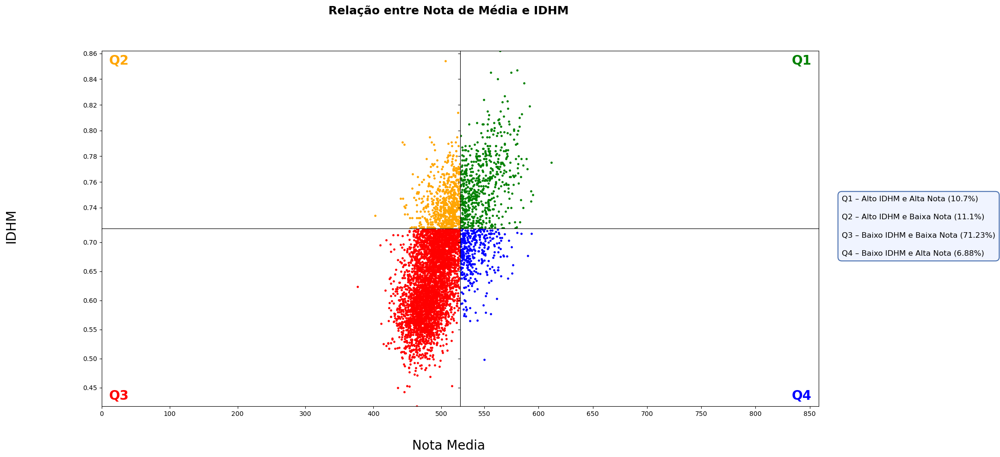

In [103]:
# Medias por municipio
mean_nota_media = media_notas_por_materia['NU_NOTA_MEDIA']

idhm_municipio = df_plot.IDHM
nota_municipio = df_plot.NU_NOTA_MEDIA

quad_1 = (idhm_municipio > mean_idhm) & (nota_municipio > mean_nota_media) 
quad_2 = (idhm_municipio > mean_idhm) & (nota_municipio < mean_nota_media) 
quad_3 = (idhm_municipio < mean_idhm) & (nota_municipio < mean_nota_media) 
quad_4 = (idhm_municipio < mean_idhm) & (nota_municipio > mean_nota_media) 

fig, ax = plt.subplots(2,2, figsize=(20,10), sharex = 'col', sharey = 'row')
plt.subplots_adjust(wspace=0, hspace=0)

# Titulo e rotulos
fig.suptitle(
    'Relação entre Nota de Média e IDHM',
    fontsize=18,
    fontweight='bold'
)

fig.supxlabel('Nota Media', fontsize=20)
fig.supylabel('IDHM', fontsize=20)

# Identificador de cada um dos quadrantes
ax[0, 1].text(
    0.98, 0.98,                  
    'Q1',
    transform=ax[0, 1].transAxes,
    fontsize=20,
    fontweight='bold',
    va='top',
    ha='right',
    color = 'green'
)
ax[0, 0].text(
    0.02, 0.98,                  
    'Q2',
    transform=ax[0, 0].transAxes,
    fontsize=20,
    fontweight='bold',
    va='top',
    ha='left',
    color = 'orange'
)
ax[1, 0].text(
    0.02, 0.02,                  
    'Q3',
    transform=ax[1, 0].transAxes,
    fontsize=20,
    fontweight='bold',
    va='bottom',
    ha='left',
    color = 'red'
)
ax[1, 1].text(
    0.98, 0.02,                  
    'Q4',
    transform=ax[1, 1].transAxes,
    fontsize=20,
    fontweight='bold',
    va='bottom',
    ha='right',
    color = 'blue'
)

# Notas/IDHM minimas e maximas
min_nota_media = dados_consolidados.NU_NOTA_MEDIA.min()
max_nota_media = dados_consolidados.NU_NOTA_MEDIA.max()
min_idhm = dados_consolidados.IDHM.min()
max_idhm = dados_consolidados.IDHM.max()

# Plot de cada um dos quadrantes
media_idhm_1 = df_plot[quad_1]
media_idhm_1.plot.scatter('NU_NOTA_MEDIA', 'IDHM', ax = ax[0,1], s=6, color = 'green',  xlim = (mean_nota_media, max_nota_media), ylim = (mean_idhm, max_idhm))

media_idhm_2 = df_plot[quad_2]
media_idhm_2.plot.scatter('NU_NOTA_MEDIA', 'IDHM', ax = ax[0,0], s=6, color = 'orange',  xlim = (min_nota_media, mean_nota_media), ylim = (mean_idhm, max_idhm))

media_idhm_3 = df_plot[quad_3]
media_idhm_3.plot.scatter('NU_NOTA_MEDIA', 'IDHM', ax = ax[1,0], s=6, color = 'red',  xlim = (min_nota_media, mean_nota_media), ylim = (min_idhm, mean_idhm))

media_idhm_4 = df_plot[quad_4]
media_idhm_4.plot.scatter('NU_NOTA_MEDIA', 'IDHM', ax = ax[1,1], s=6, color = 'blue',  xlim = (mean_nota_media, max_nota_media), ylim = (min_idhm, mean_idhm))

# Remove rotulos dos eixos de cada quadrante
for a in ax.flat:
    a.set_xlabel('')
    a.set_ylabel('')

# Legenda dos quadrantes
fig.text(
    0.925, 0.5,
    f'Q1 – Alto IDHM e Alta Nota ({np.round(100*len(media_idhm_1)/len(idhm_municipio), 2)}%)\n\n'
    f'Q2 – Alto IDHM e Baixa Nota ({np.round(100*len(media_idhm_2)/len(idhm_municipio), 2)}%)\n\n'
    f'Q3 – Baixo IDHM e Baixa Nota ({np.round(100*len(media_idhm_3)/len(idhm_municipio), 2)}%)\n\n'
    f'Q4 – Baixo IDHM e Alta Nota ({np.round(100*len(media_idhm_4)/len(idhm_municipio), 2)}%)',
    ha='left',
    va='center',
    fontsize=12,
    linespacing=1.4,
    bbox=dict(
        boxstyle='round,pad=0.5',   
        facecolor='#F0F4FF',        
        edgecolor='#4C72B0',        
        linewidth=1.5
    )
)

In [104]:
# Salvando imagem
fig.savefig('resultados/parciais/grafico_dispersao_idhm_nota_media.png', bbox_inches='tight', pad_inches = 0.25)

##### Analise por IDHM de todas as notas

In [105]:
# Configuracoes
cores_quadrantes = {
    'Q1': 'green',
    'Q2': 'orange',
    'Q3': 'red',
    'Q4': 'blue'
}

# Funcao principal
def gerar_estado(df, coluna_nota):
    mean_nota =media_notas_por_materia[coluna_nota]

    y_min = df['IDHM'].min() * 0.98
    y_max = df['IDHM'].max() * 1.02
    x_min = df[coluna_nota].min() * 0.98
    x_max = df[coluna_nota].max() * 1.02

    quad = {
        'Q1': (df.IDHM > mean_idhm) & (df[coluna_nota] > mean_nota),
        'Q2': (df.IDHM > mean_idhm) & (df[coluna_nota] <= mean_nota),
        'Q3': (df.IDHM <= mean_idhm) & (df[coluna_nota] <= mean_nota),
        'Q4': (df.IDHM <= mean_idhm) & (df[coluna_nota] > mean_nota)
    }

    traces = []
    perc = {}

    # Pontos do grafico 
    for q, mask in quad.items():
        perc[q] = 100 * mask.mean()

        traces.append(
            go.Scatter(
                x=df.loc[mask, coluna_nota],
                y=df.loc[mask, 'IDHM'],
                mode='markers',
                name=q,
                marker=dict(
                    size=6,
                    color=cores_quadrantes[q],
                    opacity=0.7
                ),
                showlegend=False,
                hovertemplate=(
                    f"<b>{q}</b><br>"
                    f"Nota: %{{x:.1f}}<br>"
                    f"IDHM: %{{y:.3f}}"
                )
            )
        )

    # Box Lateral 
    traces.extend([
        go.Scatter(
            x=[None], y=[None],
            mode='markers',
            marker=dict(size=0),
            name="<b>Distribuição</b>",
            showlegend=True
        ),
        go.Scatter(
            x=[None], y=[None],
            mode='markers',
            marker=dict(size=10, color=cores_quadrantes['Q1']),
            name=f"Q1 – Alto IDHM / Alta Nota: {perc['Q1']:.2f}%",
            showlegend=True
        ),
        go.Scatter(
            x=[None], y=[None],
            mode='markers',
            marker=dict(size=10, color=cores_quadrantes['Q2']),
            name=f"Q2 – Alto IDHM / Baixa Nota: {perc['Q2']:.2f}%",
            showlegend=True
        ),
        go.Scatter(
            x=[None], y=[None],
            mode='markers',
            marker=dict(size=10, color=cores_quadrantes['Q3']),
            name=f"Q3 – Baixo IDHM / Baixa Nota: {perc['Q3']:.2f}%",
            showlegend=True
        ),
        go.Scatter(
            x=[None], y=[None],
            mode='markers',
            marker=dict(size=10, color=cores_quadrantes['Q4']),
            name=f"Q4 – Baixo IDHM / Alta Nota: {perc['Q4']:.2f}%",
            showlegend=True
        )
    ])

    # Linhas medias 
    shapes = [
        dict(
            type="line",
            x0=mean_nota,
            x1=mean_nota,
            y0=y_min,
            y1=y_max,
            line=dict(color="black", dash="dash")
        ),
        dict(
            type="line",
            x0=x_min,
            x1=x_max,
            y0=mean_idhm,
            y1=mean_idhm,
            line=dict(color="black", dash="dash")
        )
    ]

    # Anotacoes medias 
    annotations = [
        dict(
            x=mean_nota,
            y=y_max,
            xref='x',
            yref='y',
            text=f"Média Nota: {mean_nota:.1f}",
            showarrow=False,
            font=dict(size=12),
            bgcolor='white',
            bordercolor='black',
            borderwidth=1,
            xanchor='center',
            yanchor='bottom'
        ),
        dict(
            x=x_max,
            y=mean_idhm,
            xref='x',
            yref='y',
            text=f"Média IDHM: {mean_idhm:.3f}",
            showarrow=False,
            font=dict(size=12),
            bgcolor='white',
            bordercolor='black',
            borderwidth=1,
            xanchor='left',
            yanchor='middle'
        )
    ]

    layout = dict(
        title=dict(
            text=f"<b>Relação entre {coluna_nota.replace('NU_NOTA_', 'Nota ')} e IDHM</b>",
            x=0.5
        ),
        xaxis=dict(title="Nota", range=[x_min, x_max]),
        yaxis=dict(title="IDHM", range=[y_min, y_max]),
        shapes=shapes,
        annotations=annotations
    )

    return traces, layout

# Figura inicial
nota_inicial = colunas_notas[-1]
traces_ini, layout_ini = gerar_estado(df_plot_tds_notas, nota_inicial)

fig = go.Figure(data=traces_ini)
fig.update_layout(layout_ini)

# Frames
frames = []
for nota in colunas_notas:
    traces, layout = gerar_estado(df_plot_tds_notas, nota)
    frames.append(go.Frame(name=nota, data=traces, layout=layout))

fig.frames = frames

# Botoes
buttons = [
    dict(
        label=nota.replace('NU_NOTA_', ''),
        method='animate',
        args=[
            [nota],
            dict(
                mode='immediate',
                frame=dict(duration=500, redraw=True),
                transition=dict(duration=300)
            )
        ]
    )
    for nota in colunas_notas
]

# Layout final
fig.update_layout(
    template='plotly_white',
    showlegend=True,
    legend=dict(
        x=1.0,
        y=0.95,
        xanchor='left',
        yanchor='middle',
        bgcolor="#F0F4FF",
        bordercolor="#4C72B0",
        borderwidth=1.5,
        itemclick=False,
        itemdoubleclick=False
    ),
    margin=dict(l=80, r=320, t=80, b=80),
    updatemenus=[
        dict(
            type='buttons',
            direction='down',
            buttons=buttons,
            x=-0.25,
            y=0.5,
            xanchor='left',
            yanchor='middle'
        )
    ]
)

fig.show()

In [106]:
# Salvando em html
fig.write_html(
    'resultados/parciais/notas_idhm_interativo.html',  
    include_plotlyjs='cdn',               
    full_html=True,                         
    auto_open=False,                        
    auto_play = False    
)

#### Município

In [107]:
df_plot_tds_notas = (
    dados_consolidados
    .groupby('CO_MUNICIPIO_ESC')
    .agg({
        **{col: 'mean' for col in ['latitude', 'longitude','IDHM', 'NU_NOTA_CN', 'NU_NOTA_CH', 'NU_NOTA_LC', 'NU_NOTA_MT', 'NU_NOTA_REDACAO', 'NU_NOTA_MEDIA']},
        'Município': 'first'
    })
    .sort_values(by='Município')
)

In [108]:
# Resetar indices para tirar coluna do indice, isso eh necessario para usar as proximas bibliotecas
df_plot_tds_notas = df_plot_tds_notas.reset_index() 

##### Plot da Nota Media por latitude e longitude dos municipios

<Axes: title={'center': 'Nota Media por Municipio'}, xlabel='longitude', ylabel='latitude'>

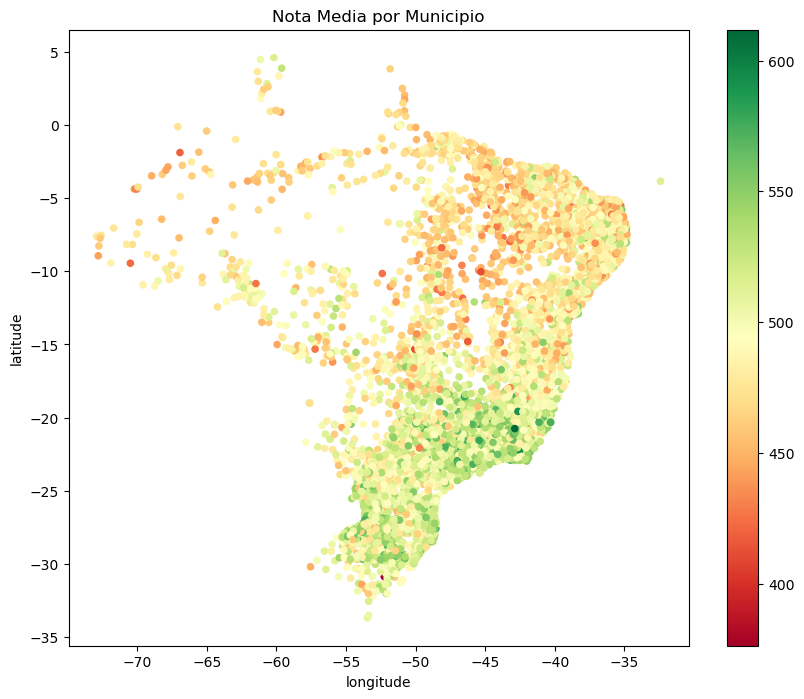

In [109]:
df_plot_tds_notas.plot.scatter(y = 'latitude', x = 'longitude', c = df_plot_tds_notas['NU_NOTA_MEDIA'], cmap = 'RdYlGn' ,  figsize = (10,8), title = 'Nota Media por Municipio')

##### Plot da todas as notas por latitude e longitude dos municipios (subplots)

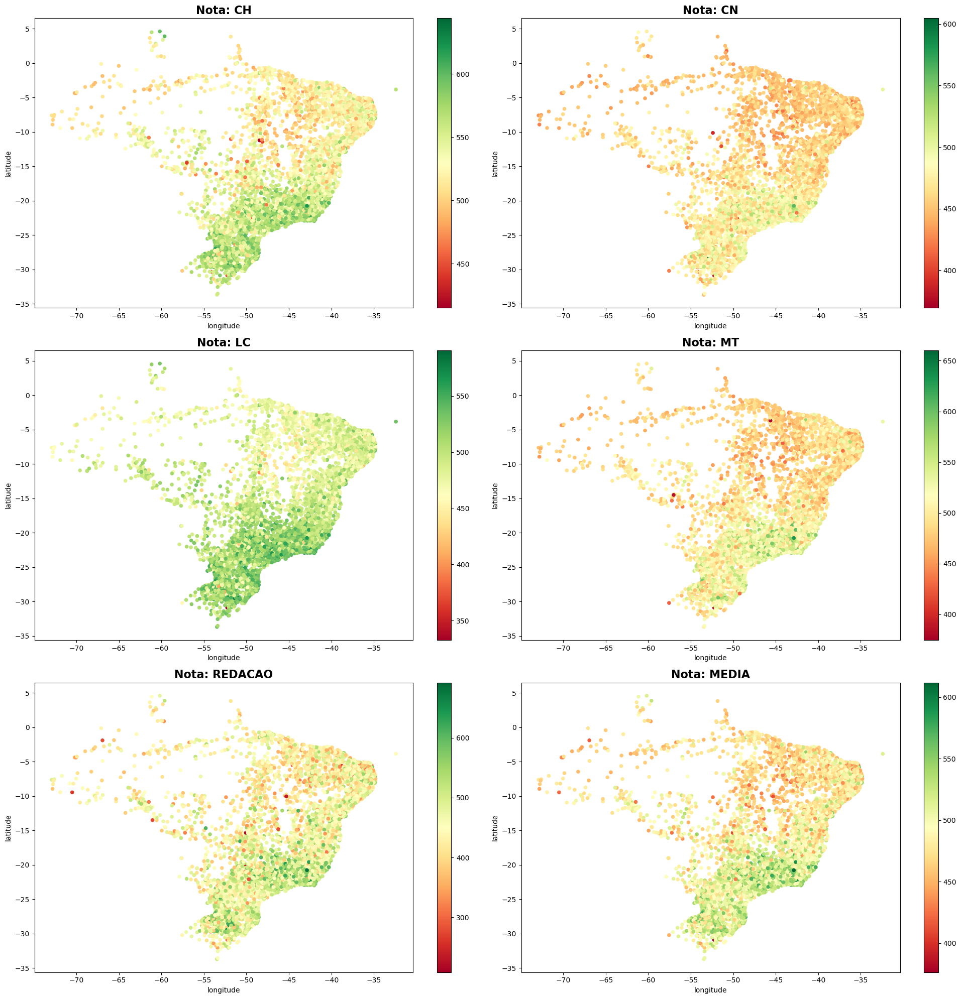

In [110]:
fig, ax = plt.subplots(3, 2, figsize=(20,20))
ax = ax.ravel()  # transforma em array 1D para percorrer facilmente

for i, coluna in enumerate(colunas_notas):
    df_plot_tds_notas.plot.scatter(
        x='longitude',
        y='latitude',
        c=coluna,
        cmap='RdYlGn',
        ax=ax[i],
        colorbar=True  
    )
    
    # Remove titulo da colorbar, pois o titulo de cada subplot eh o suficiente 
    ax[i].collections[0].colorbar.set_label('')
    
    # Titulo do subplot
    ax[i].set_title(f'Nota: {coluna.replace("NU_NOTA_", "")}', fontsize=16, weight = 'bold')

plt.tight_layout()
plt.show()

In [111]:
# Salvando imagem
fig.savefig('resultados/parciais/grafico_notas_por_municipio_lat_long.png', bbox_inches='tight', pad_inches = 0.25)

##### Plot da todas as notas por latitude e longitude dos municipios (interativo)

In [112]:
# Colunas das notas + IDHM
colunas_notas = [
    "NU_NOTA_CH",
    "NU_NOTA_CN",
    "NU_NOTA_LC",
    "NU_NOTA_MT",
    "NU_NOTA_REDACAO",
    "NU_NOTA_MEDIA",
    "IDHM"
]

# Figura base
fig = go.Figure()

# Criar frames para cada nota
for nota in colunas_notas:
    fig.add_trace(
        go.Scattermapbox(
            lat=df_plot_tds_notas['latitude'],
            lon=df_plot_tds_notas['longitude'],
            mode='markers',
            marker=dict(
                size=8,
                color=df_plot_tds_notas[nota],
                colorscale='RdYlGn',
                cmin=df_plot_tds_notas[nota].min(),
                cmax=df_plot_tds_notas[nota].max(),
                colorbar=dict(
                    title='',  
                    x=1.05
                )
            ),
            customdata=df_plot_tds_notas[['Município', nota]],  
            hovertemplate=(
                "<b>%{customdata[0]}</b><br>"  
                "<b>Valor:</b> <b>%{customdata[1]:.2f}</b>"
            ),
            name=nota,
            visible=(nota == 'NU_NOTA_MEDIA') 
        )
    )

# Botoes para trocar a nota
buttons = []
for i, nota in enumerate(colunas_notas):
    visibility = [False]*len(colunas_notas)
    visibility[i] = True
    buttons.append(dict(
        label=nota.replace('NU_NOTA_', ''),
        method='update',
        args=[
            {'visible': visibility},
            {'title': f'Mapa Brasil - {nota.replace("NU_NOTA_", "Nota ")}'}
        ]
    ))

fig.update_layout(
    autosize=True,
    #width=1000,
    #height=800,
    mapbox_style='carto-positron',
    mapbox_zoom=3.35,
    mapbox_center={'lat': -14.2, 'lon': -51.9},
    title=dict(
        text='Mapa Brasil',
        x=0.5,
        xanchor='center',
        yanchor='top',
        y=0.98,
        font=dict(size=20)
    ),
    updatemenus=[dict(
        type='buttons',
        showactive=True,
        direction='right',
        x=0.5,
        y=1.0,
        xanchor='center',
        yanchor='bottom',
        buttons=buttons
    )],
    margin=dict(t=120) 
)

fig.show()

In [113]:
# Salvando em html
fig.write_html(
    'resultados/parciais/notas_idhm_colormap_interativo.html',  
    include_plotlyjs='cdn',               
    full_html=True,                         
    auto_open=False,                        
    auto_play = False    
)

#### Visualizacao completa

In [114]:
# Lista dos HTML's gerados anteriormente
arquivos_html = [
    'resultados/parciais/notas_faixa_etaria_interativo_animado.html',
    'resultados/parciais/notas_sexo_interativo_animado.html',
    'resultados/parciais/notas_escolaridade_interativo_animado.html',
    'resultados/parciais/notas_renda_mensal_familiar_interativo_animado.html',
    'resultados/parciais/notas_idhm_interativo.html',
    'resultados/parciais/notas_idhm_colormap_interativo.html'
]

# Nome das abas
nomes_abas = [
    "Faixa Etária",
    "Sexo",
    "Escolaridade",
    "Renda Mensal Familiar",
    "IDHM",
    "Município"
]

# Funcao: extrair conteudo util do HTML Plotly
def extrair_plotly(html_texto):
    # Remove html/head/body
    html_texto = re.sub(r"<\/?(html|head|body).*?>", "", html_texto, flags=re.I|re.S)

    # Remove inclusao duplicada do plotly.js
    html_texto = re.sub(
        r"<script[^>]*plotly[^>]*>.*?<\/script>",
        "",
        html_texto,
        flags=re.I|re.S
    )

    return html_texto.strip()

# Carregar e extrair os htmls
conteudos = []
for arquivo in arquivos_html:
    texto = Path(arquivo).read_text(encoding="utf-8")
    conteudos.append(extrair_plotly(texto))

# HTML final
html_dashboard = f"""
<!DOCTYPE html>
<html lang="pt-br">
<head>
<meta charset="UTF-8">
<title>Dashboard ENEM 2018</title>

<script src="https://cdn.plot.ly/plotly-2.30.0.min.js"></script>

<style>
html, body {{
    width: 100%;
    height: 100%;
    margin: 0;
    padding: 0;
}}

body {{
    display: flex;
    flex-direction: column;
    font-family: Arial;
    background: #f8f9fa;
}}

header {{
    padding: 16px;
    text-align: center;
}}

h1 {{
    margin: 0;
    font-size: 26px;
    color: #2C3E50;
}}

.tabs {{
    display: flex;
    justify-content: center;
    flex-wrap: wrap;
    padding: 8px;
}}

.tab-button {{
    background: #4C72B0;
    color: white;
    border: none;
    padding: 10px 18px;
    margin: 4px;
    cursor: pointer;
    font-size: 15px;
    border-radius: 6px 6px 0 0;
}}

.tab-button.active {{
    background: #2A4A7C;
    font-weight: bold;
}}

.tab-container {{
    flex: 1;
    min-height: 0;
    position: relative;
}}

.tab-content {{
    position: absolute;
    inset: 0;
    visibility: hidden;
    opacity: 0;
    pointer-events: none;
}}

.tab-content.active {{
    visibility: visible;
    opacity: 1;
    pointer-events: auto;
}}

.tab-content > div {{
    width: 100%;
    height: 100%;
}}
</style>
</head>

<body>

<header>
<h1>Dashboard de Análise Gráfica do ENEM 2018</h1>
</header>

<div class="tabs">
"""

for i, nome in enumerate(nomes_abas):
    active = "active" if i == 0 else ""
    html_dashboard += f'<button class="tab-button {active}" onclick="openTab({i})">{nome}</button>\n'

html_dashboard += "</div><div class='tab-container'>"

for i, conteudo in enumerate(conteudos):
    active = "active" if i == 0 else ""
    html_dashboard += f"<div class='tab-content {active}'>{conteudo}</div>\n"

html_dashboard += """
</div>

<script>
function openTab(index) {
    const tabs = document.querySelectorAll('.tab-content');
    const buttons = document.querySelectorAll('.tab-button');

    tabs.forEach((t, i) => {
        if (i === index) {
            t.style.visibility = "visible";
            t.style.opacity = "1";
            t.style.pointerEvents = "auto";
            t.style.zIndex = "1";
        } else {
            t.style.visibility = "hidden";
            t.style.opacity = "0";
            t.style.pointerEvents = "none";
            t.style.zIndex = "0";
        }
    });

    buttons.forEach((b, i) =>
        b.classList.toggle('active', i === index)
    );
}
</script>

</body>
</html>
"""

In [115]:
# Salvar e abrir
saida = Path("resultados/dashboard_interativo_completo_analise_enem_2018.html")
saida.write_text(html_dashboard, encoding="utf-8")
webbrowser.open(saida.resolve().as_uri())

True